# Utils

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
def extract_file_name(file_path):
  """
  Extracts the file name from a file path.

  Args:
    file_path (str): The file path.

  Returns:
    str: The file name without the extension.
  """
  # Split the file path into a list of strings
  parts = file_path.split("/")
  # Get the last element in the list (the file name)
  file_name = parts[-1]
  # Split the file name into a list of strings
  parts = file_name.split(".")
  # Get the first element in the list (the file name without the extension)
  file_name = parts[0]

  return file_name

def read_images_and_names(dir_path, func=None):
    """
    Read all images and their corresponding names in a directory and return them as a list of tuples.
    Each tuple in the list contains a NumPy array representing the image and a string representing the name of the image.

    Parameters:
        dir_path (str): The path to the directory containing the images and their names.

    Returns:
        images_and_names: A list of tuples, where each tuple contains a NumPy array representing the image and a string representing the name of the image.
    """
    images_and_names = []
    for filename in os.listdir(dir_path):
        # Check if file is an image
        if filename.endswith(".png") or filename.endswith(".jpg") or filename.endswith(".PNG") or filename.endswith(
                ".JPG") or filename.endswith(".jpeg"):
            # Read image and store as NumPy array
            file_path = os.path.join(dir_path, filename)
            image = cv2.imread(file_path)
            if func is not None:
              image = func(image)
            image_name = extract_file_name(file_path)
            images_and_names.append((image, image_name))
    return images_and_names

# Segments-ai

In [ ]:
!pip install --upgrade segments-ai

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.2/51.2 kB 6.3 MB/s eta 0:00:00
  Created wheel for segments-ai: filename=segments_ai-1.0.23-py3-none-any.whl size=37566 sha256=a7d351b02e33df427535bb262480279c3a45235948cc416f63ed3ba0352aae86
  Stored in directory: /root/.cache/pip/wheels/fe/4c/f9/1ef800a67632027b047d0de89cb1d1027fab2498008c25ca36
Successfully built segments-ai


In [ ]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import cv2
import os
import pickle
from segments import SegmentsClient
import json
import pandas as pd
from segments.utils import load_image_from_url, load_label_bitmap_from_url, get_semantic_bitmap

In [ ]:
# You can find your api key at https://segments.ai/account
api_key = "e022f204199f265634b16cf18485bdd53cb7becf"
client = SegmentsClient(api_key)
dataset = 'etaylor/trichomes_moment_lens_instance_segmentation'
sample = client.get_samples(dataset)

In [ ]:
def get_ground_truth(index, dataset):
    sample = client.get_samples(dataset)[index]
    label = client.get_label(sample.uuid, labelset='ground-truth')
    total = len(label.attributes.annotations)
    # Load the labels as numpy arrays
    image = load_image_from_url(sample.attributes.image.url)
    instance_bitmap = load_label_bitmap_from_url(label.attributes.segmentation_bitmap.url)
    semantic_bitmap = instance_bitmap.copy()
    semantic_bitmap[instance_bitmap > 0] = 1
    return image, instance_bitmap, semantic_bitmap, total, sample.name

def build_ground_truth_dict(dataset):
    ground_truth_dict = {}
    num_samples = len(client.get_samples(dataset))

    for i in range(num_samples):
        image, instance_bitmap, semantic_bitmap, total, name = get_ground_truth(i, dataset)
        name = name.split('.')[0]
        ground_truth_dict[name] = {
            'image': image,
            'instance_bitmap': instance_bitmap,
            "semantic_bitmap": semantic_bitmap,
            'total_annotations': total,
        }

    return ground_truth_dict


In [ ]:
ground_truth = build_ground_truth_dict(dataset)

# Read Images

In [ ]:
patches_path = "/content/drive/MyDrive/Thesis: Cannabis maturity assessment project/trichomes patches - week5 3xzoom"
images_names = read_images_and_names(patches_path)
images, names = zip(*images_names)

# SAM

In [ ]:
using_colab = True

In [ ]:
if using_colab:
    import torch
    import torchvision
    print("PyTorch version:", torch.__version__)
    print("Torchvision version:", torchvision.__version__)
    print("CUDA is available:", torch.cuda.is_available())
    import sys
    !{sys.executable} -m pip install opencv-python matplotlib
    !{sys.executable} -m pip install 'git+https://github.com/facebookresearch/segment-anything.git'

    !wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth

In [ ]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import cv2
import os

In [ ]:
def show_anns(anns):
    # If there are no annotations, exit the function early
    if len(anns) == 0:
        return

    # Sort the annotations by area in descending order
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)

    # Get the current axis (plot) on which to draw
    ax = plt.gca()
    # Disable autoscaling of the axis
    ax.set_autoscale_on(False)

    # Create a transparent image of the same size as the first (largest) annotation
    img = np.ones((sorted_anns[0]['segmentation'].shape[0], sorted_anns[0]['segmentation'].shape[1], 4))
    img[:,:,3] = 0

    # Loop over each annotation
    for ann in sorted_anns:
        # Get the mask for this annotation
        m = ann['segmentation']

        # Generate a random color for this mask (RGB + alpha, where alpha is 0.35)
        color_mask = np.concatenate([np.random.random(3), [0.35]])

        # Apply the color to the mask on the image
        img[m] = color_mask

    # Display the image with the colored masks
    ax.imshow(img)

In [ ]:
import sys
sys.path.append("..")
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor

sam_checkpoint = "sam_vit_h_4b8939.pth"
model_type = "vit_h"

device = "cuda"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

mask_generator = SamAutomaticMaskGenerator(sam)

In [ ]:
def segments_patches_SAM(images_names):
    segmentation_dict = {}

    for image, name in images_names:
        mask = mask_generator.generate(image)
        num_segments = len(mask)

        # Initialize an array of False with the same shape as the segment masks
        instance_bitmap = np.zeros_like(mask[0]['segmentation'], dtype=bool)

        # create a single instance bitmap
        for seg in mask:
          instance_bitmap = np.logical_or(instance_bitmap, seg['segmentation'])


        segmentation_dict[name] = {
            'mask': mask,
            'num_segments': num_segments,
            "instance_bitmap": instance_bitmap,
        }

    return segmentation_dict

Run the SAM model on the image patches

In [ ]:
SAM_pred = segments_patches_SAM(images_names)

# Measure SAM scores with default settings

In [ ]:
def calculate_precision_recall_per_segment(gt_dict, pred_dict, iou_threshold):
    TPs = 0 # True positives
    FPs = 0 # False positives
    FNs = 0 # False negatives
    iou_values = []  # list to store IOU values

    gt_segments = np.unique(gt_dict['instance_bitmap']) # List of unique segments in ground truth
    gt_segments = gt_segments[gt_segments != 0] # Exclude the background (0)

    matched_gt_segments = set() # Track which gt segments have been matched

    # Iterate over each predicted segment
    for segment in pred_dict['mask']:
        pred_mask = segment['segmentation']
        max_iou = 0
        best_match_gt_seg = None

        for seg in gt_segments:
            if seg not in matched_gt_segments:  # Only consider unmatched gt segments
                gt_mask = (gt_dict['instance_bitmap'] == seg) # mask for current gt segment
                intersection = np.logical_and(gt_mask, pred_mask)
                union = np.logical_or(gt_mask, pred_mask)
                iou = np.sum(intersection) / np.sum(union)

                if iou > max_iou:
                    max_iou = iou
                    best_match_gt_seg = seg

        if max_iou >= iou_threshold and best_match_gt_seg is not None:
            TPs += 1 # We have a true positive
            matched_gt_segments.add(best_match_gt_seg) # This gt segment has been matched
        else:
            FPs += 1 # We have a false positive

        iou_values.append(max_iou)  # Add the max IOU to the list

    # Calculate false negatives by subtracting the number of matched gt segments from total gt segments
    FNs = len(gt_segments) - len(matched_gt_segments)

    precision = TPs / (TPs + FPs) if TPs + FPs > 0 else 0
    recall = TPs / (TPs + FNs) if TPs + FNs > 0 else 0

    return precision, recall, (TPs, FPs, FNs), iou_values


In [ ]:
def plot_masks(y_true, y_pred):
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))  # 1 row, 3 columns
    image = y_true['image']
    y_true_mask = y_true['instance_bitmap']
    y_pred_mask = y_pred['mask']

    # Plot Original image
    ax[0].imshow(image)
    ax[0].set_title('Original Image')
    ax[0].axis('off')

    # Plot ground truth
    ax[1].imshow(image)
    ax[1].imshow(y_true_mask, alpha=0.5, cmap='jet')  # Overlays the mask on the image, adjust alpha to your needs
    ax[1].set_title('Ground Truth')
    ax[1].axis('off')

    # Plot prediction
    ax[2].imshow(image)
    show_anns(y_pred_mask)
    ax[2].set_title('Prediction')
    ax[2].axis('off')

    plt.show()

import seaborn as sns

def plot_confusion_matrix(TPs, FPs, FNs):
    confusion_matrix = [[TPs, FPs],
                        [FNs, 0]] # Note that we don't have TNs in this case

    # Create a heatmap
    plt.figure(figsize=(6,4))
    heatmap = sns.heatmap(confusion_matrix, annot=True, fmt='d', cmap='Blues')

    # Set labels
    heatmap.xaxis.set_ticklabels(['Positive', 'Negative'])
    heatmap.yaxis.set_ticklabels(['Positive', 'Negative'])
    heatmap.xaxis.tick_top() # x axis on top
    heatmap.xaxis.set_label_position('top')

    # Add axis labels
    plt.xlabel('Actual')
    plt.ylabel('Predicted')

    plt.show()

def plot_iou_histogram(iou_values, bins=10):
    plt.figure(figsize=(10, 6))
    plt.hist(iou_values, bins=bins, edgecolor='black')
    plt.xlabel('IOU')
    plt.ylabel('Frequency')
    plt.title('Histogram of IOU Values')
    plt.show()


In [ ]:
def calculate_average_precision_recall(ground_truth, SAM_pred, iou_threshold):
    total_precision = 0
    total_recall = 0
    total_TPs = 0
    total_FPs = 0
    total_FNs = 0
    all_iou_values = []
    num_images = len(ground_truth)

    for name in ground_truth:
        precision, recall, (TPs, FPs, FNs), iou_values = calculate_precision_recall_per_segment(ground_truth[name], SAM_pred[name], iou_threshold)
        total_precision += precision
        total_recall += recall
        total_TPs += TPs
        total_FPs += FPs
        total_FNs += FNs
        all_iou_values.extend(iou_values)

    average_precision = total_precision / num_images
    average_recall = total_recall / num_images

    return average_precision, average_recall, (total_TPs, total_FPs, total_FNs), all_iou_values


Calculate average metrics for images

Average precision: 0.3888639382377114
Average recall: 0.9277655895365067


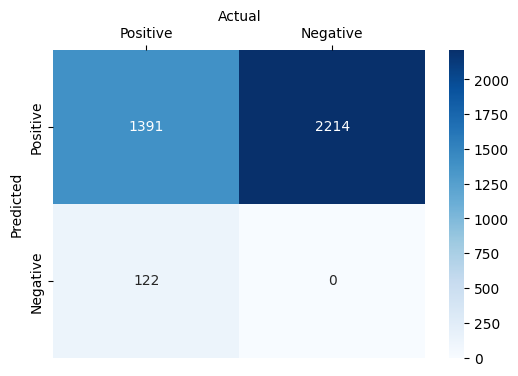

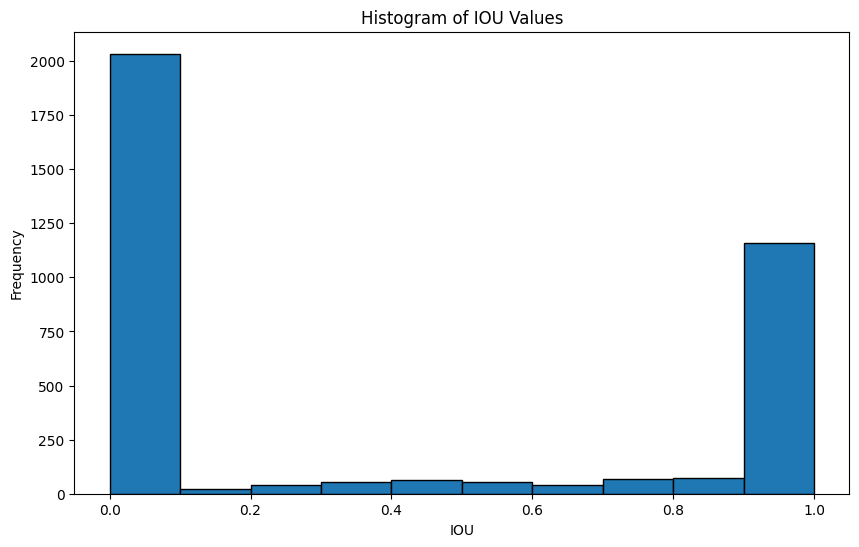

In [ ]:
# Call the function
average_precision, average_recall, (total_TPs, total_FPs, total_FNs), all_iou_values = calculate_average_precision_recall(ground_truth, SAM_pred, iou_threshold=0.5)

print(f'Average precision: {average_precision}')
print(f'Average recall: {average_recall}')
plot_confusion_matrix(total_TPs, total_FPs, total_FNs)
plot_iou_histogram(all_iou_values)

Calculate metrics for each image

----------- Analysis for IMG_0003_p18 ----------- 



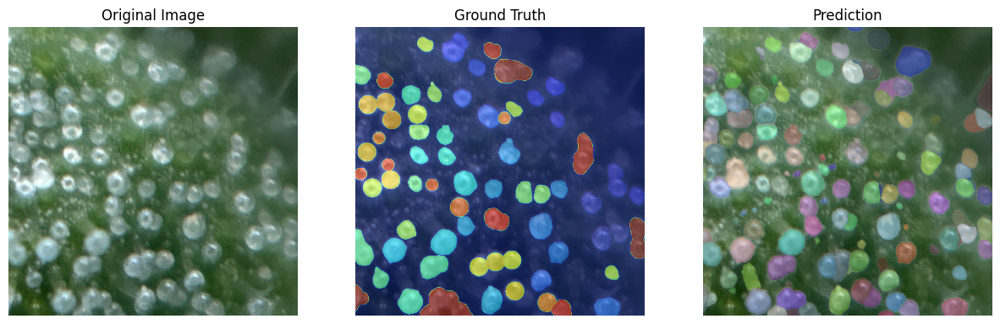

--- Precision = 0.45774647887323944, Recall = 0.8904109589041096---



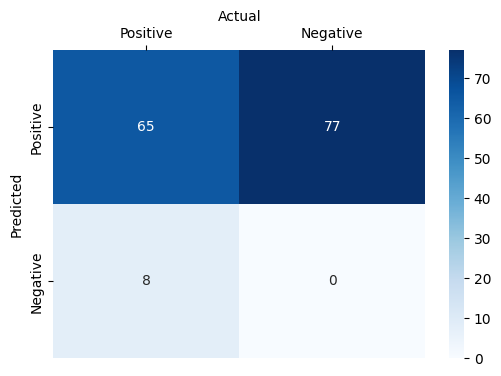

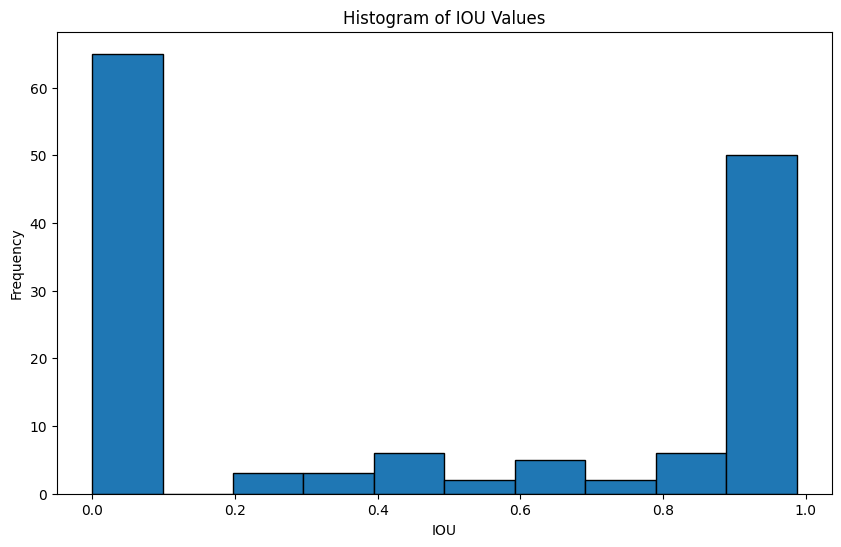

----------- Analysis for IMG_0003_p26 ----------- 



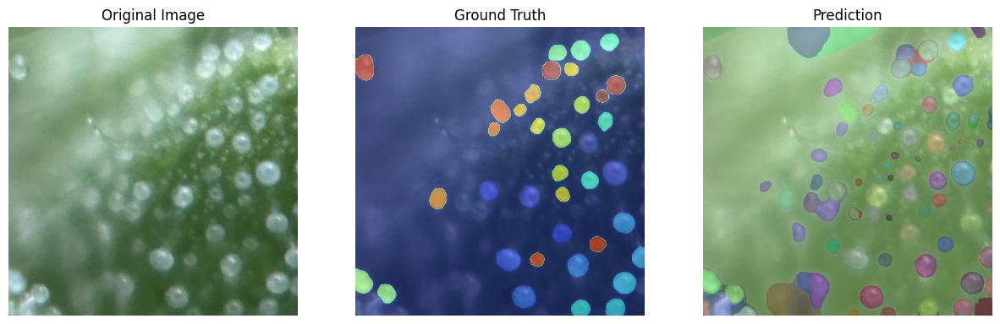

--- Precision = 0.40217391304347827, Recall = 1.0---



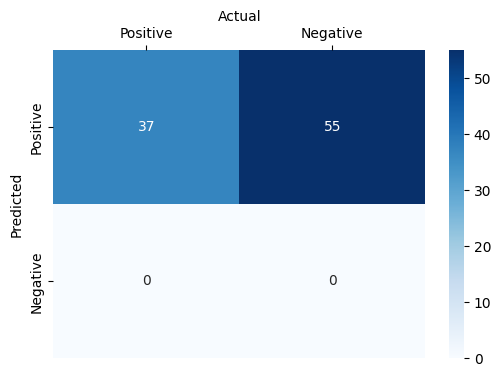

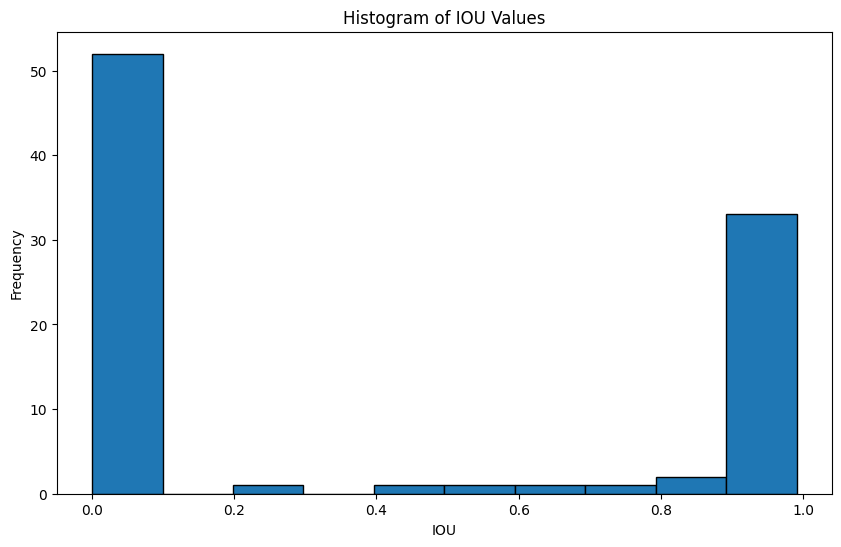

----------- Analysis for IMG_0003_p27 ----------- 



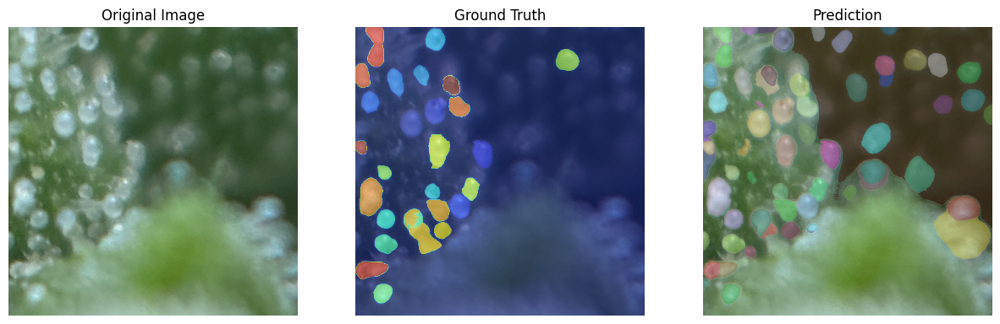

--- Precision = 0.36231884057971014, Recall = 0.9259259259259259---



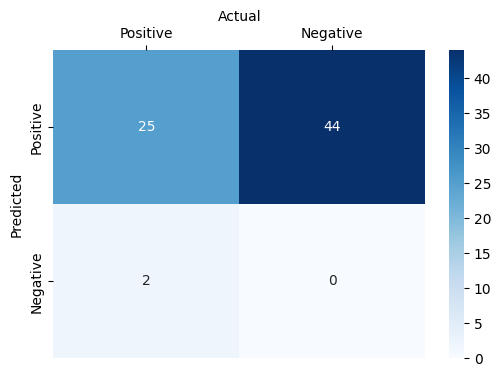

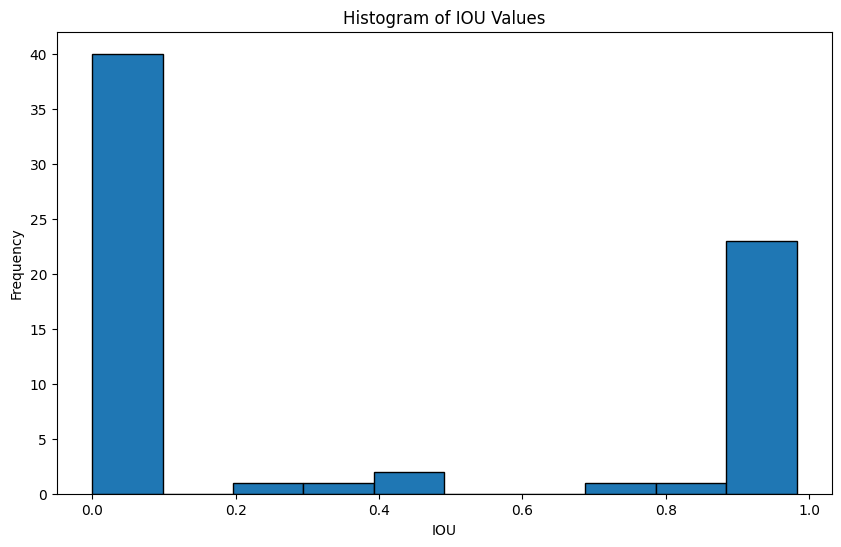

----------- Analysis for IMG_0003_p2 ----------- 



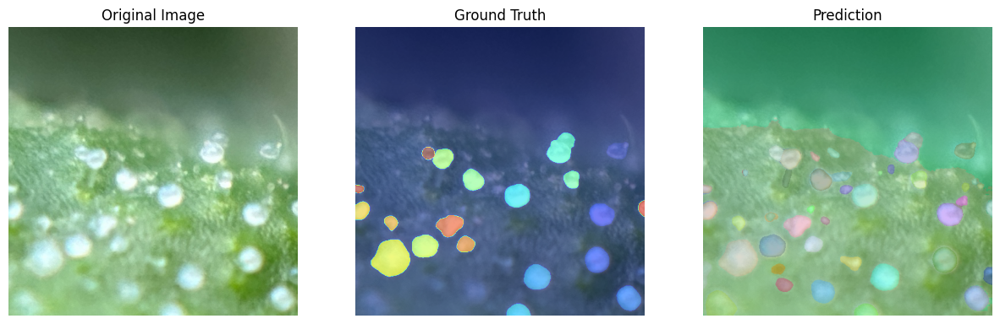

--- Precision = 0.36363636363636365, Recall = 1.0---



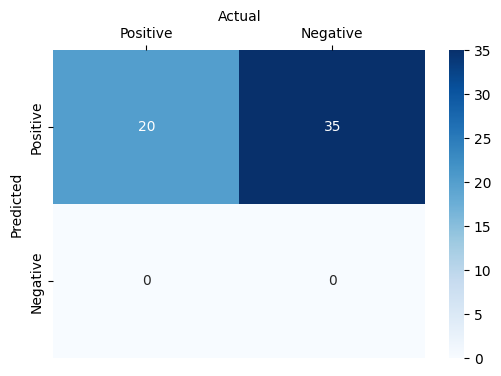

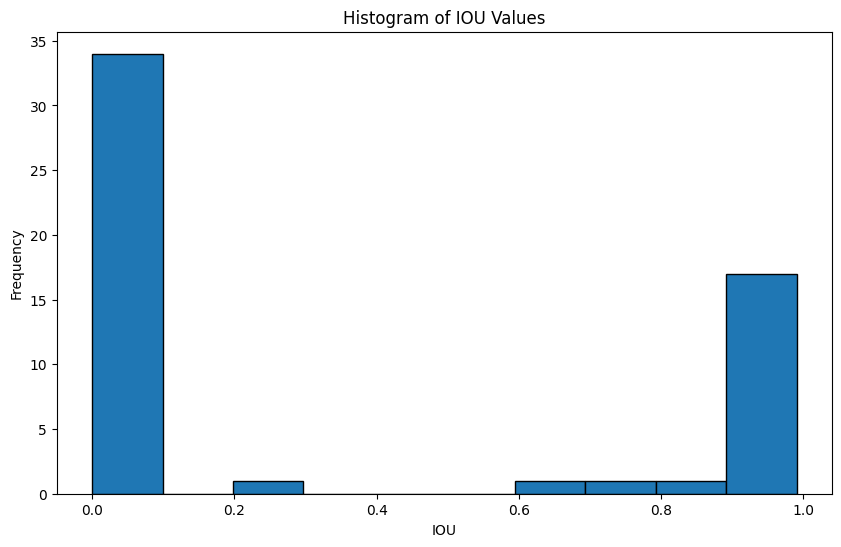

----------- Analysis for IMG_0003_p30 ----------- 



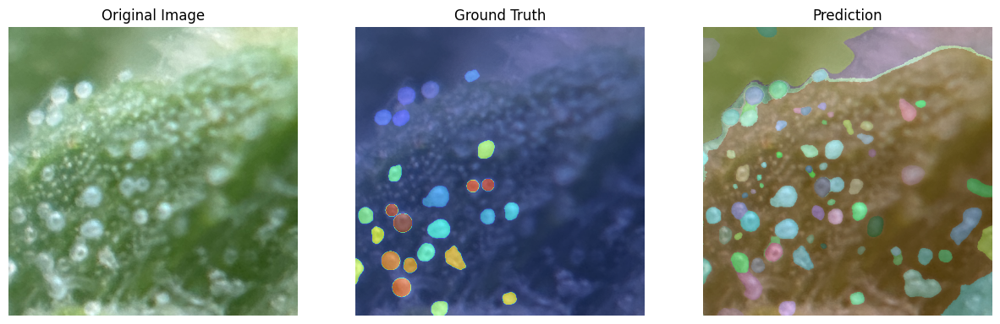

--- Precision = 0.2875, Recall = 0.92---



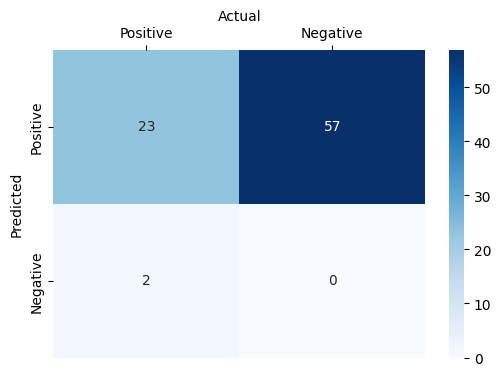

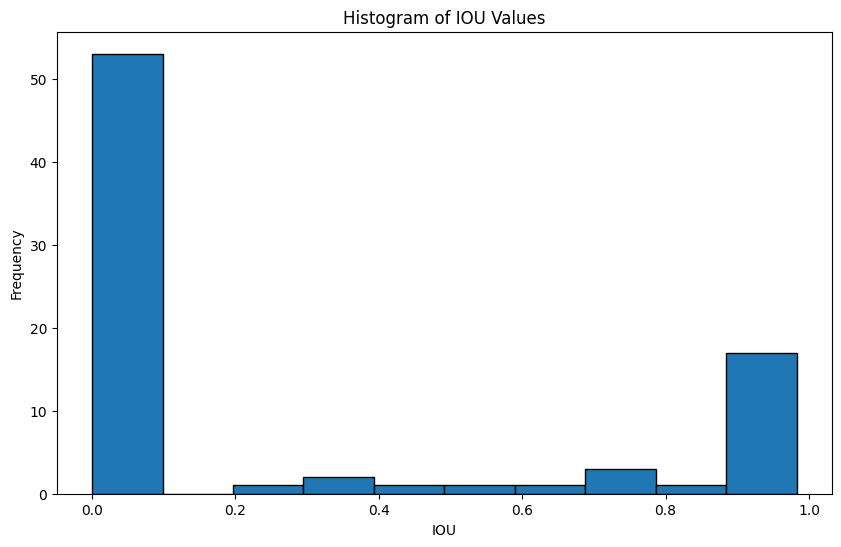

----------- Analysis for IMG_0003_p31 ----------- 



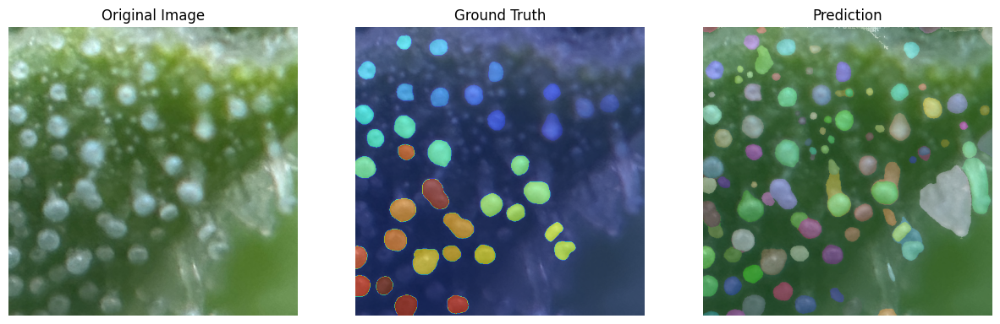

--- Precision = 0.34951456310679613, Recall = 1.0---



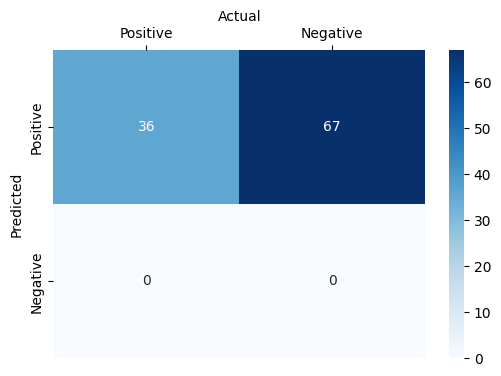

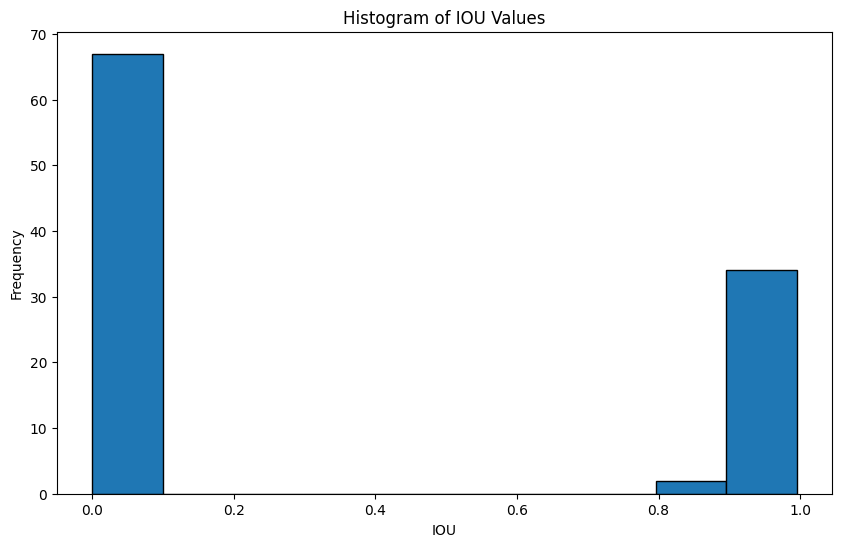

----------- Analysis for IMG_0003_p32 ----------- 



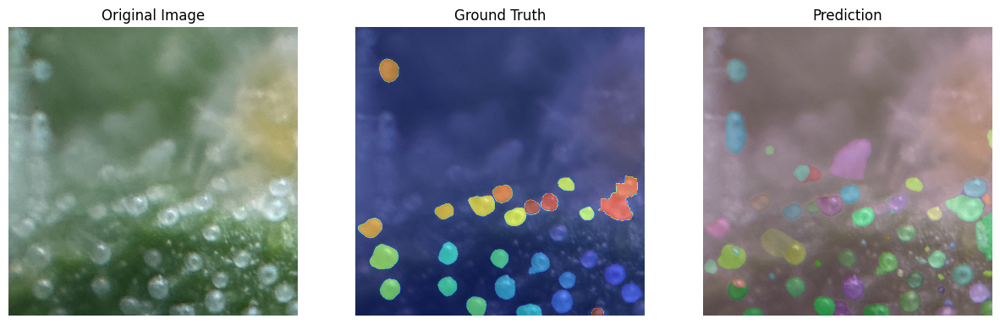

--- Precision = 0.4117647058823529, Recall = 1.0---



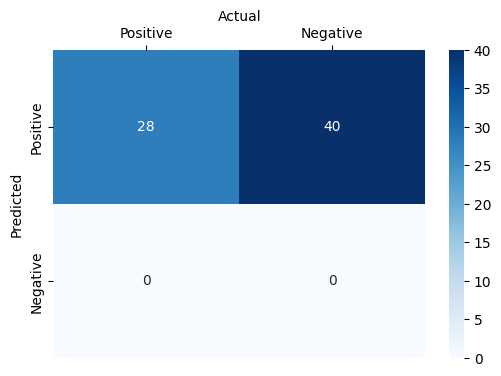

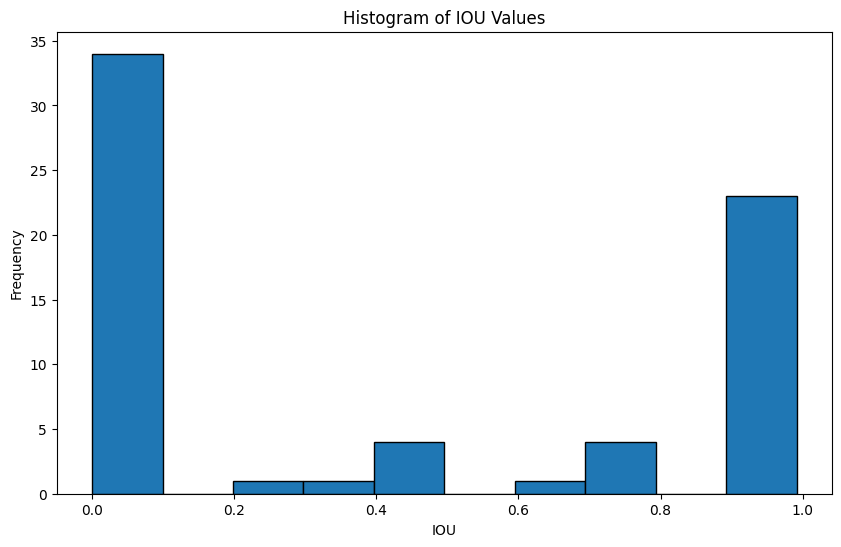

----------- Analysis for IMG_0003_p6 ----------- 



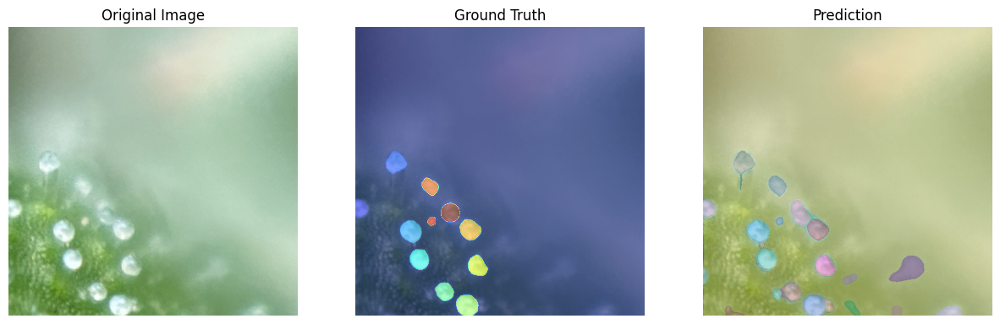

--- Precision = 0.44, Recall = 1.0---



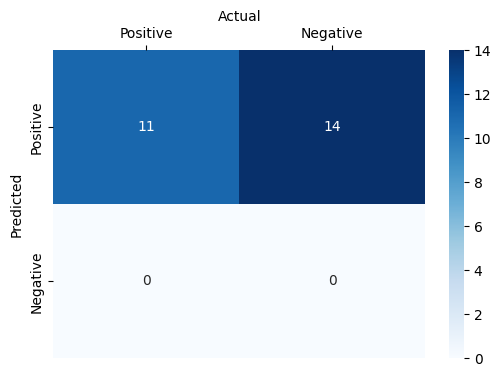

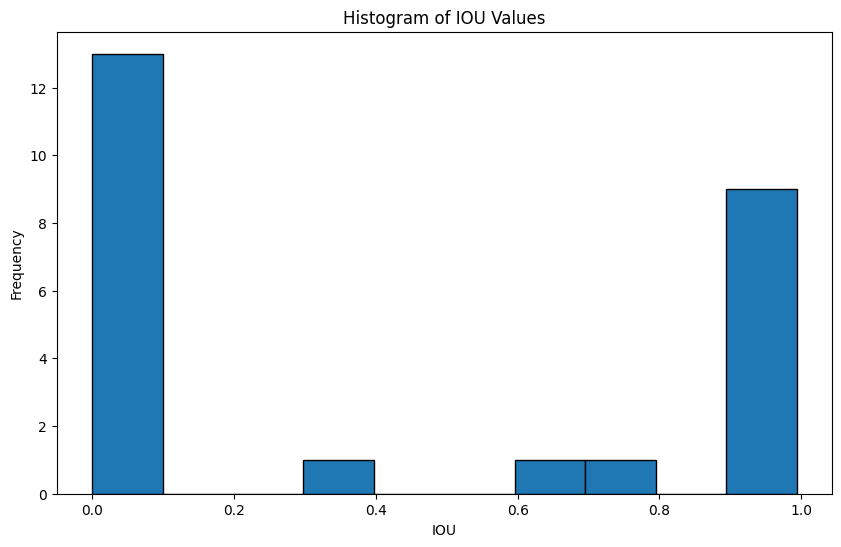

----------- Analysis for IMG_0003_p7 ----------- 



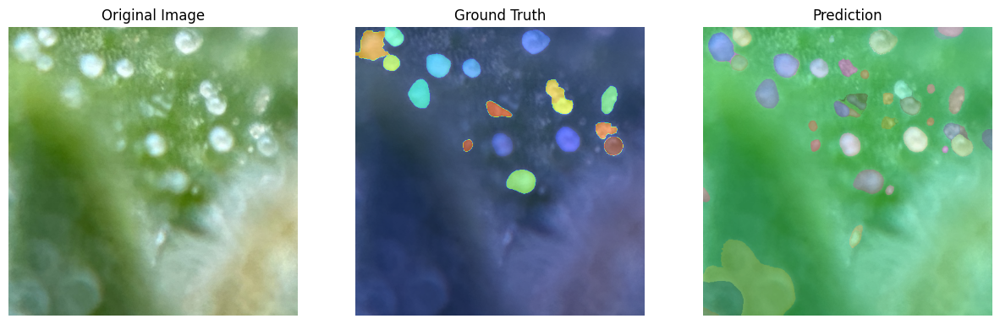

--- Precision = 0.3695652173913043, Recall = 1.0---



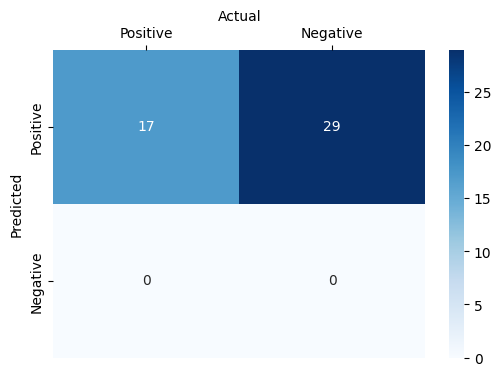

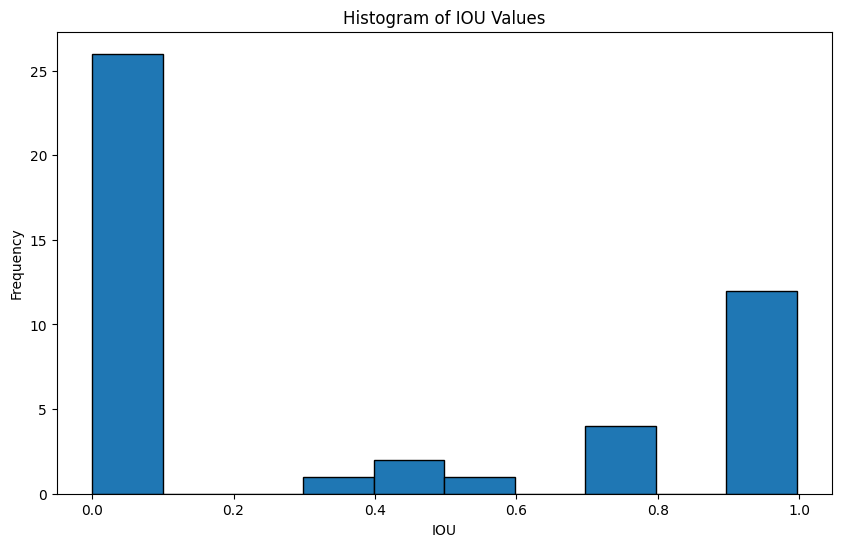

----------- Analysis for IMG_0021_p11 ----------- 



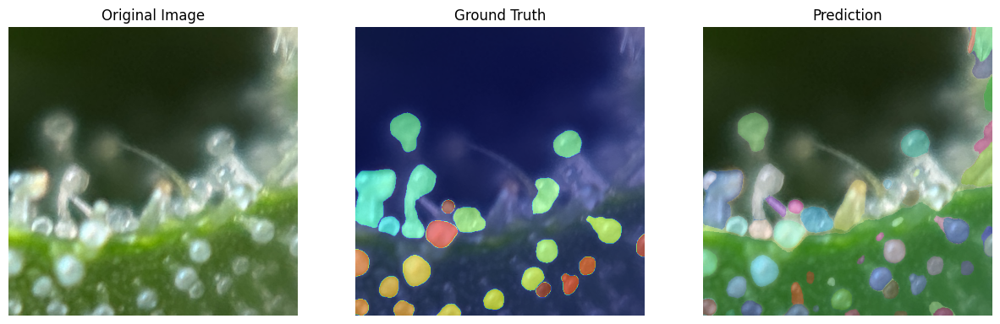

--- Precision = 0.38596491228070173, Recall = 0.9565217391304348---



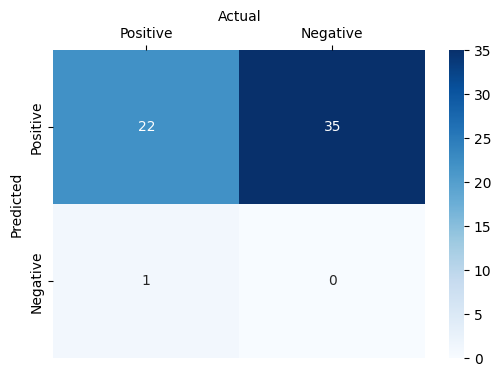

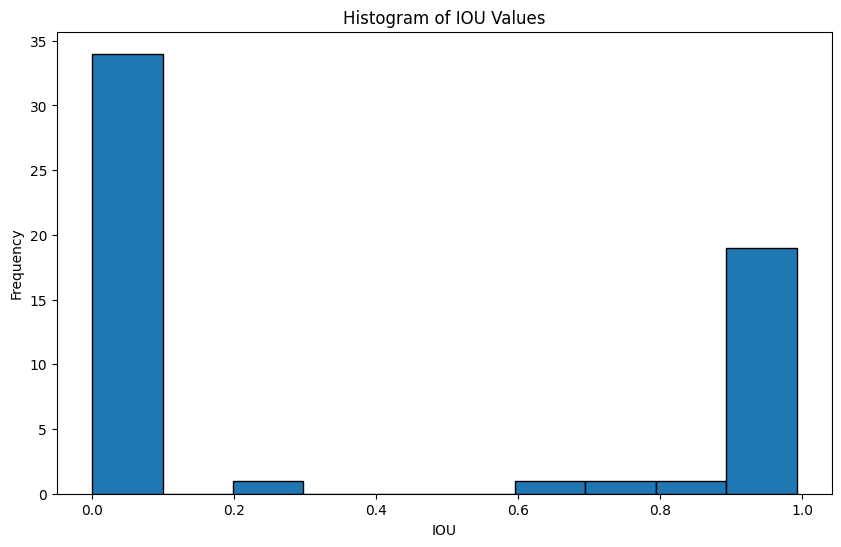

----------- Analysis for IMG_0021_p23 ----------- 



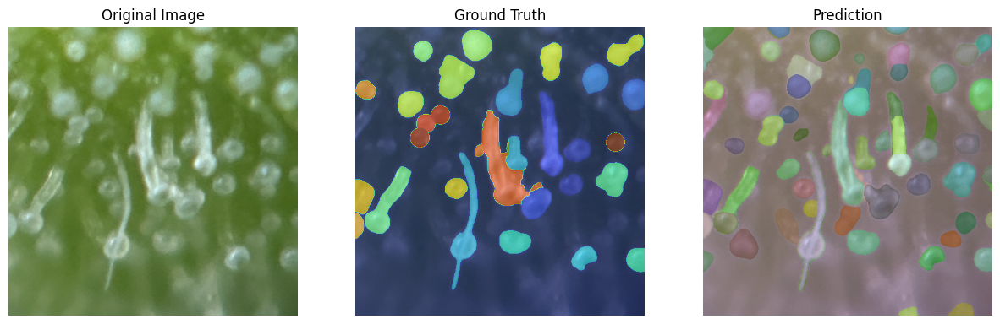

--- Precision = 0.34782608695652173, Recall = 0.8888888888888888---



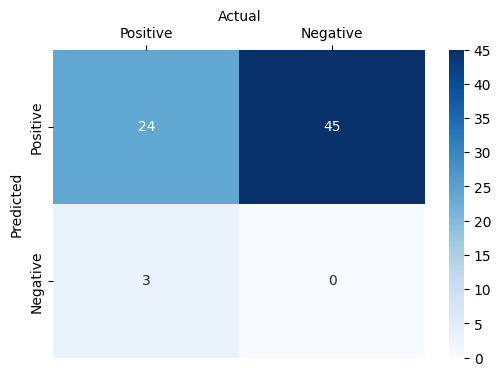

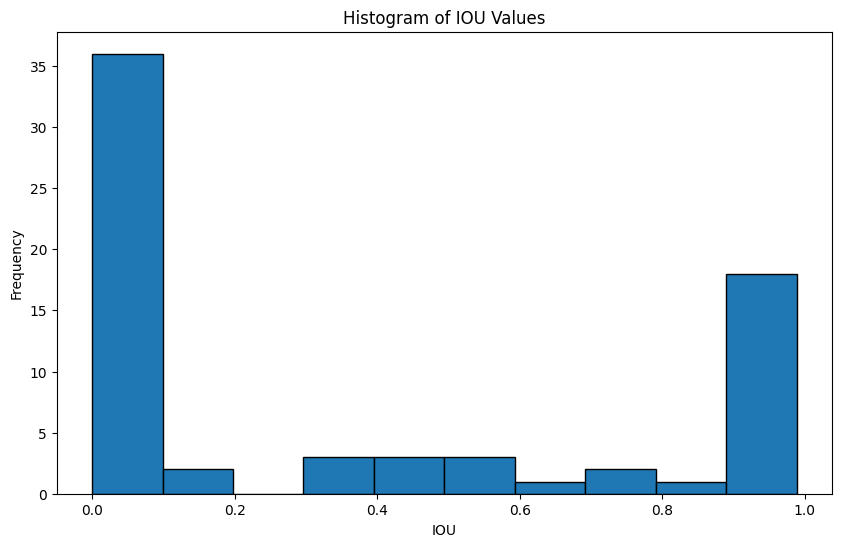

----------- Analysis for IMG_0021_p27 ----------- 



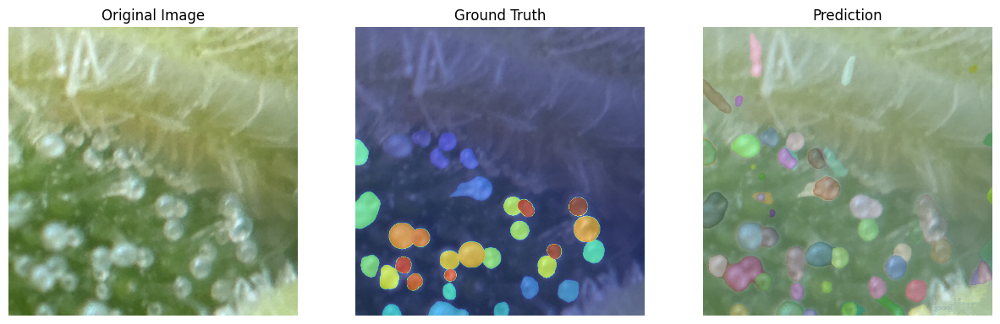

--- Precision = 0.4032258064516129, Recall = 0.78125---



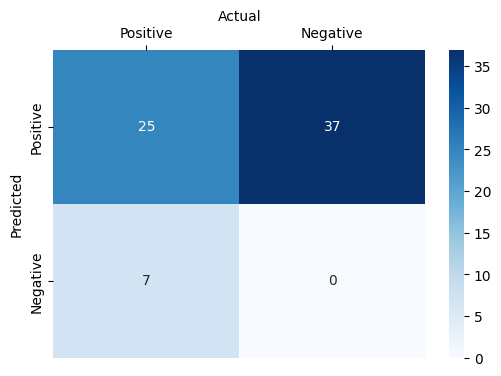

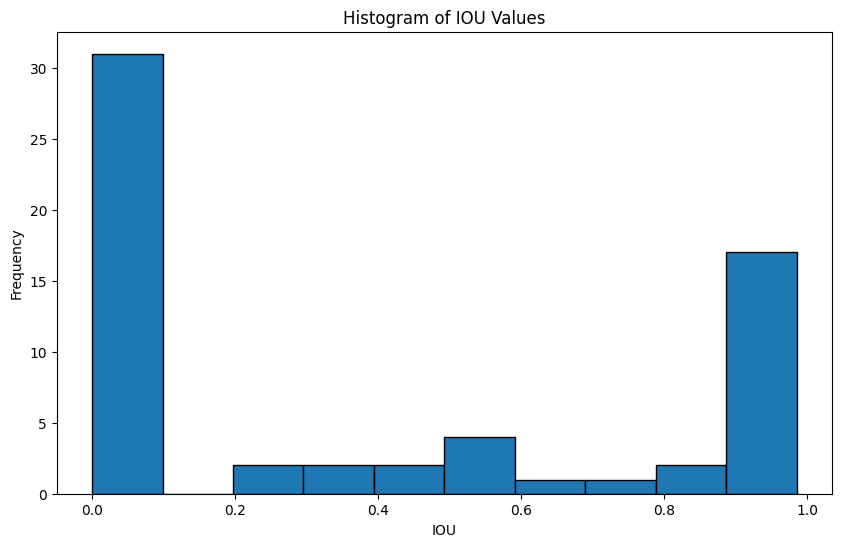

----------- Analysis for IMG_0021_p6 ----------- 



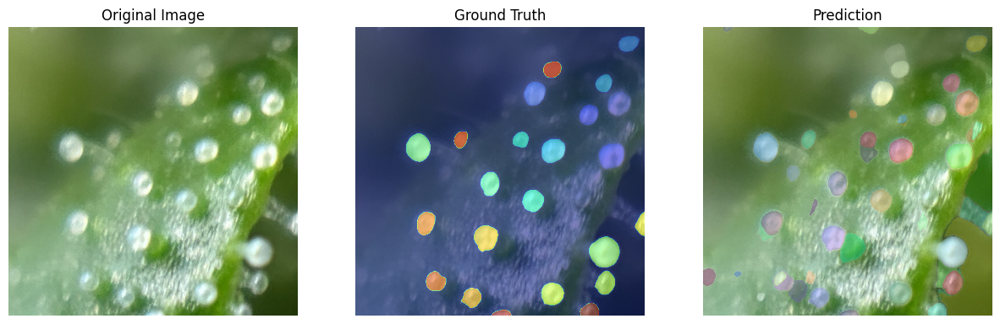

--- Precision = 0.46938775510204084, Recall = 1.0---



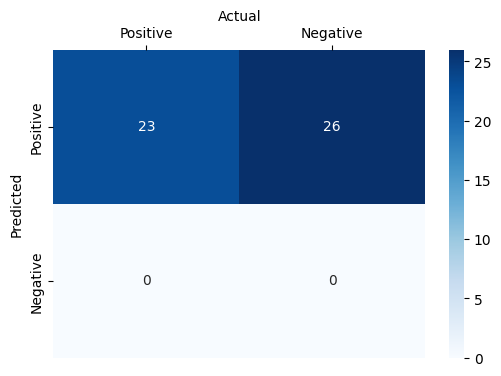

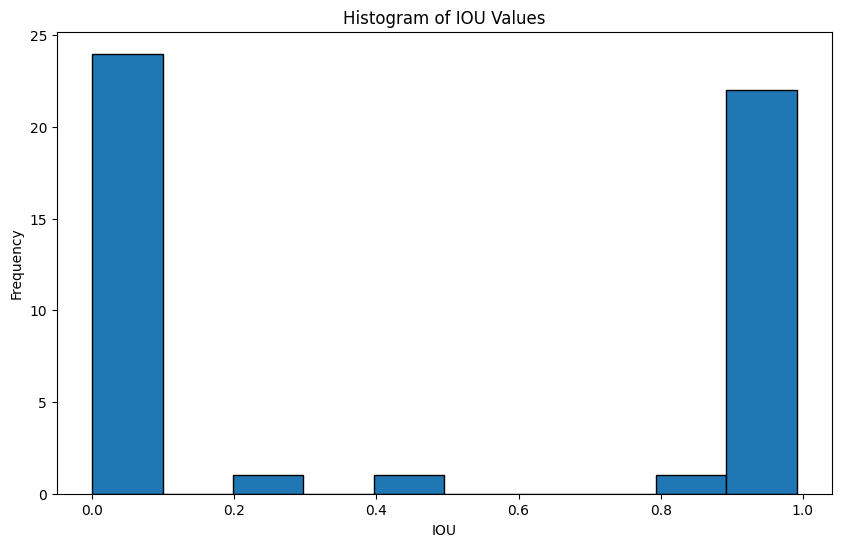

----------- Analysis for IMG_0021_p7 ----------- 



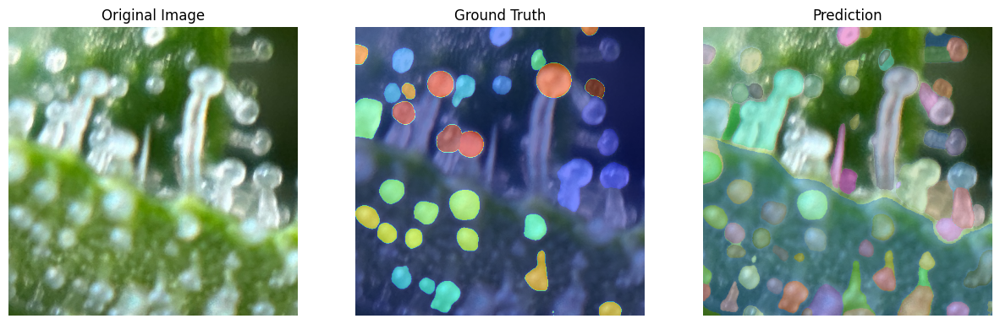

--- Precision = 0.3625, Recall = 0.8529411764705882---



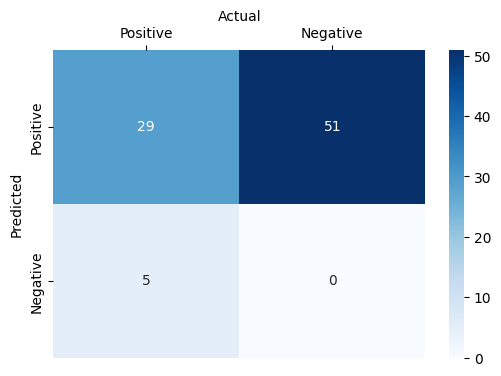

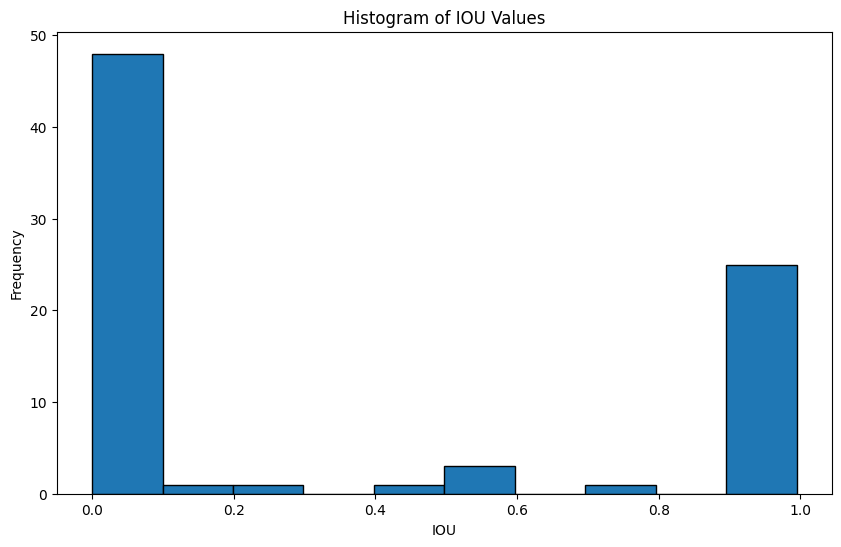

----------- Analysis for IMG_0023_p29 ----------- 



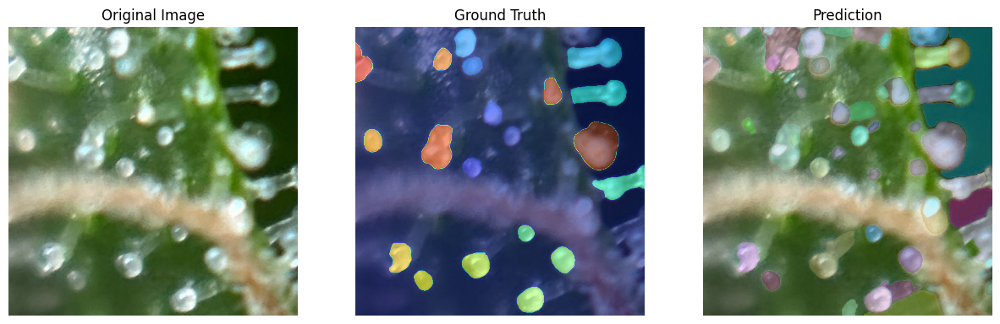

--- Precision = 0.3125, Recall = 1.0---



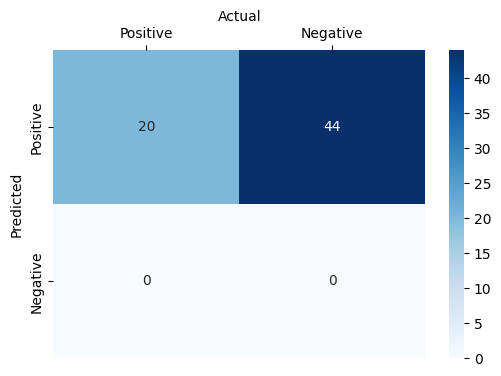

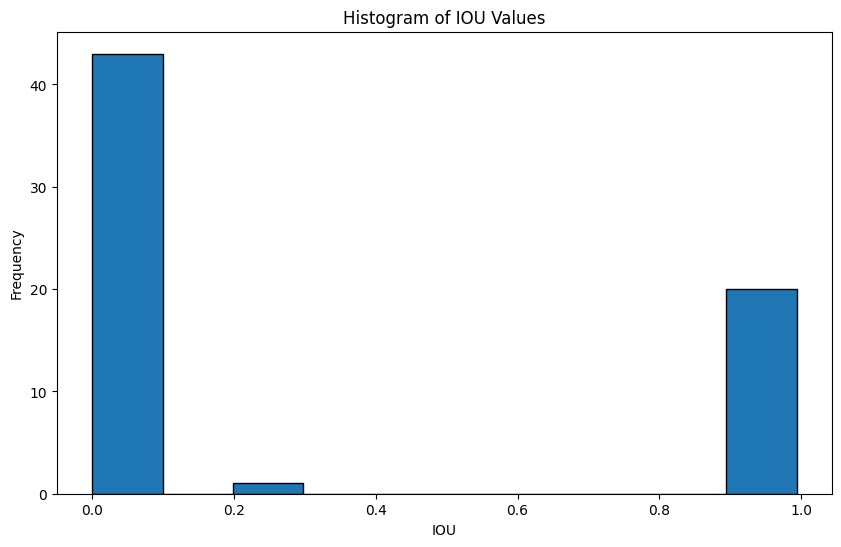

----------- Analysis for IMG_0023_p2 ----------- 



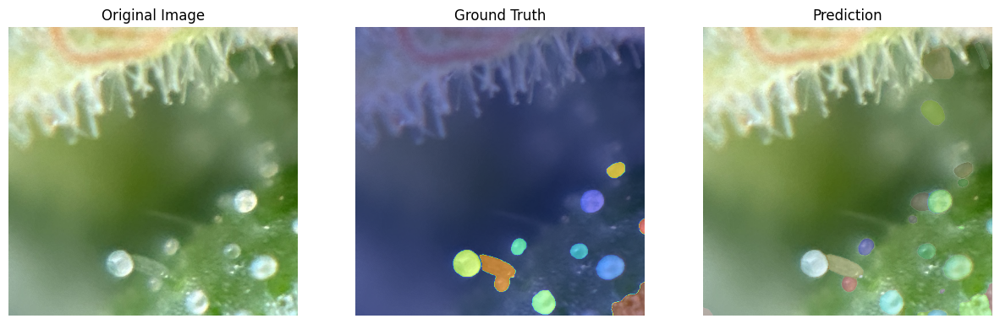

--- Precision = 0.3333333333333333, Recall = 1.0---



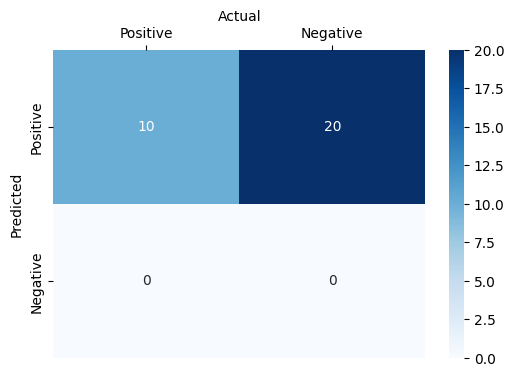

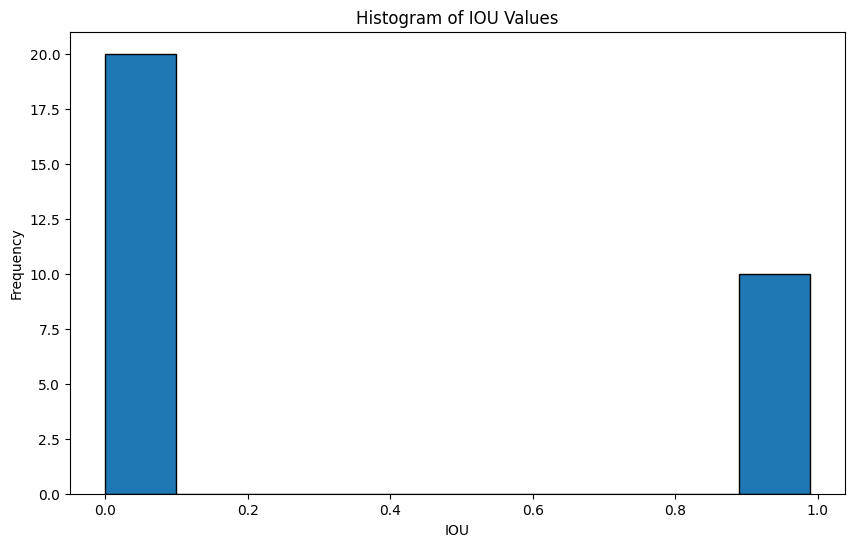

----------- Analysis for IMG_0023_p30 ----------- 



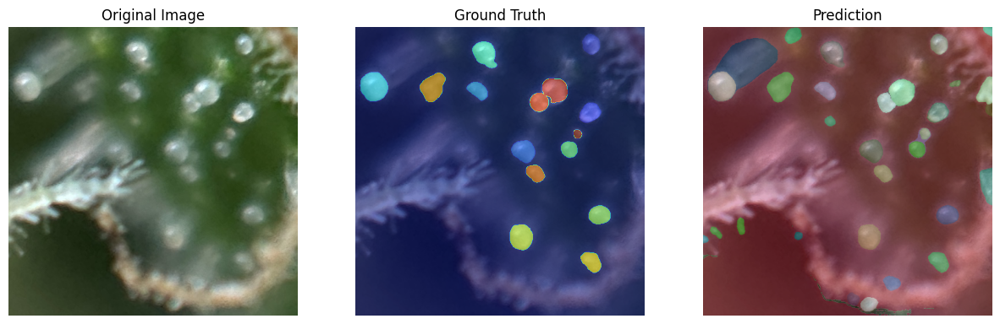

--- Precision = 0.4411764705882353, Recall = 1.0---



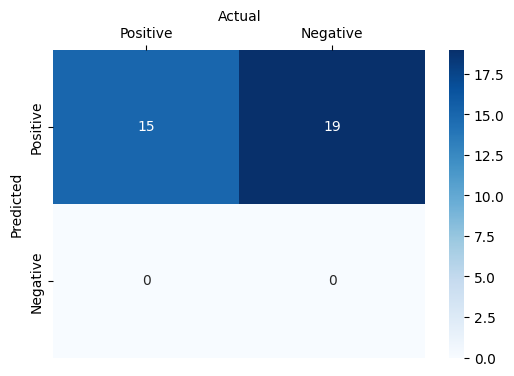

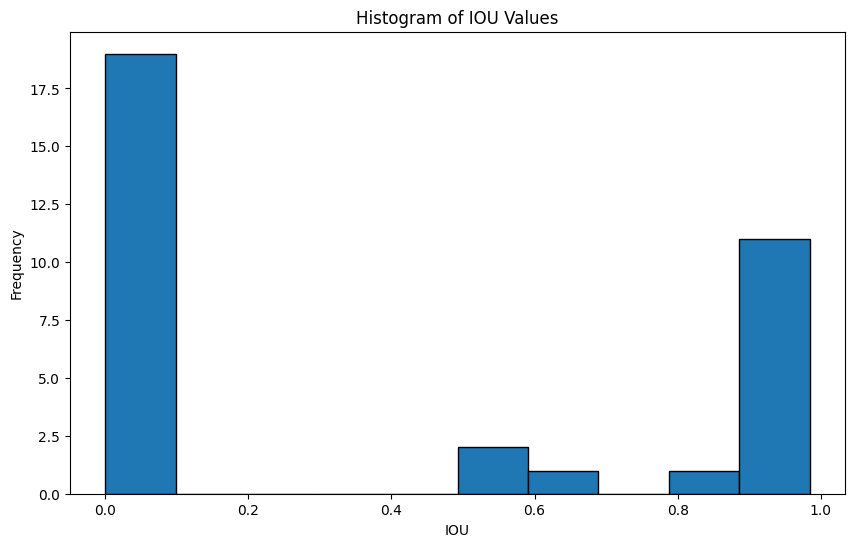

----------- Analysis for IMG_0023_p31 ----------- 



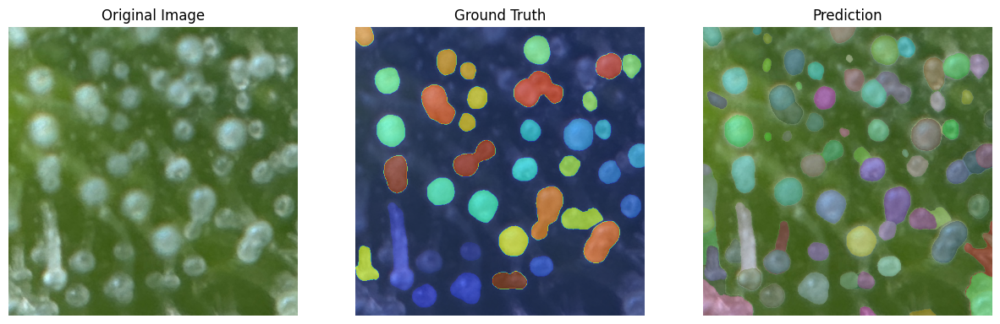

--- Precision = 0.43529411764705883, Recall = 1.0---



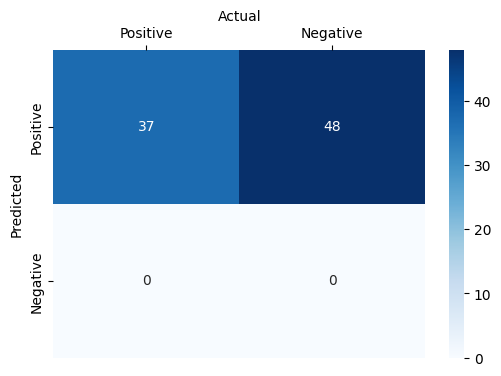

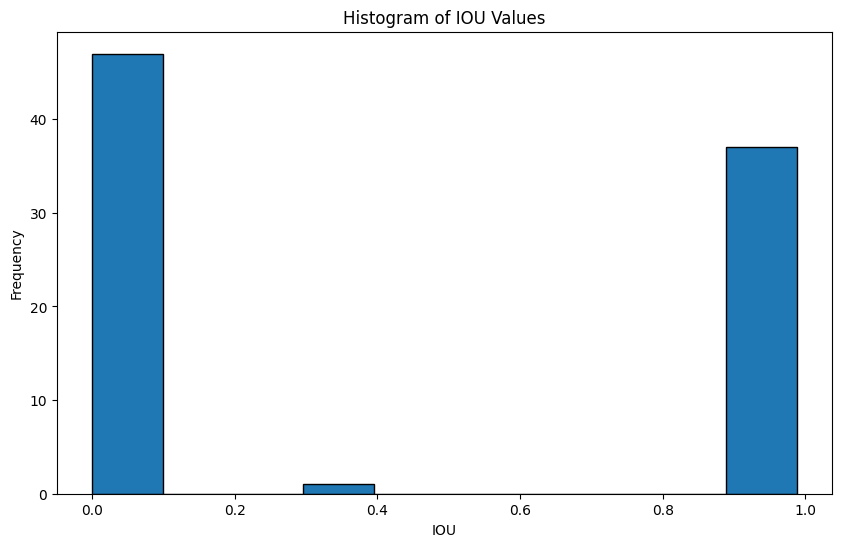

----------- Analysis for IMG_0023_p8 ----------- 



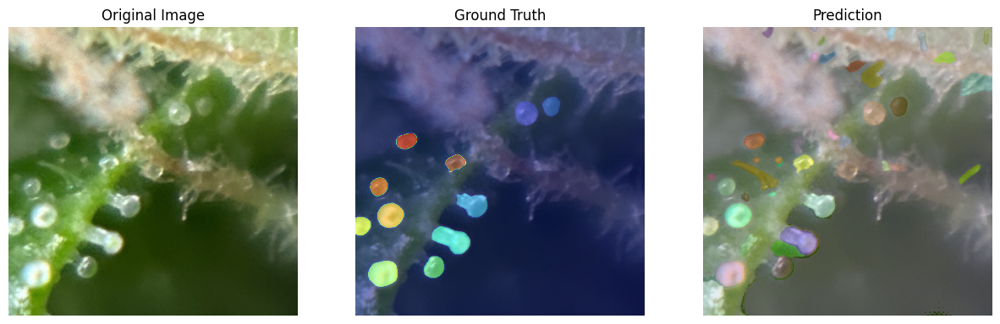

--- Precision = 0.2619047619047619, Recall = 1.0---



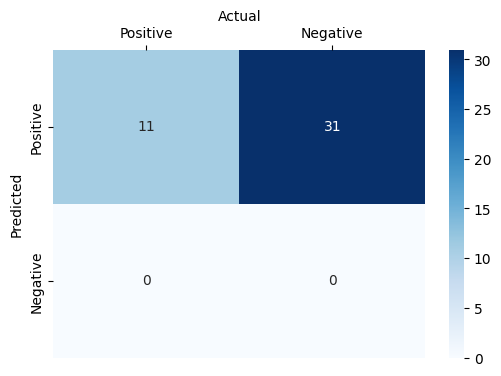

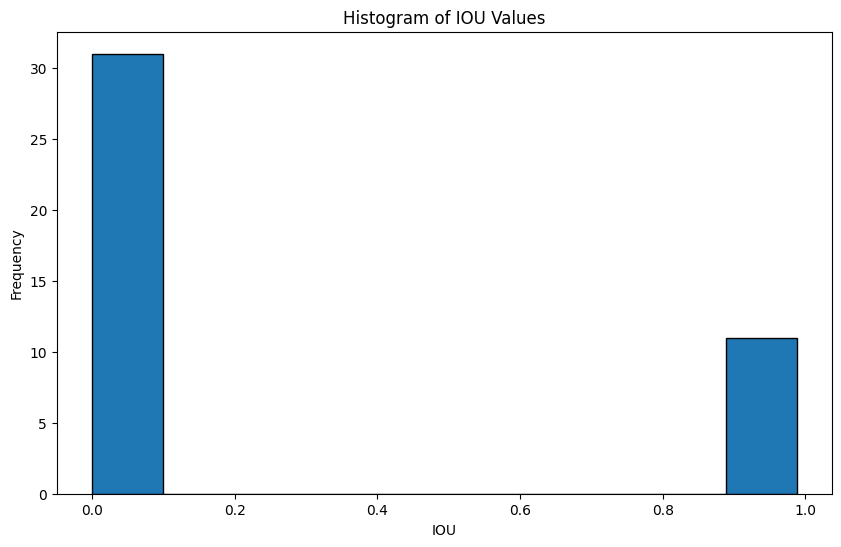

----------- Analysis for IMG_0044_p16 ----------- 



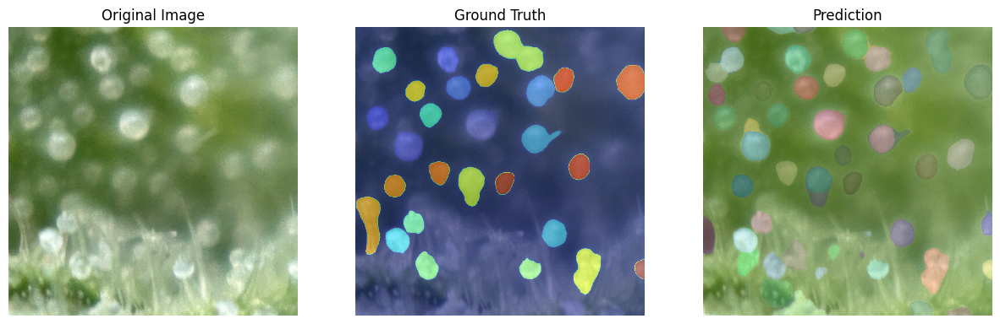

--- Precision = 0.49056603773584906, Recall = 0.9629629629629629---



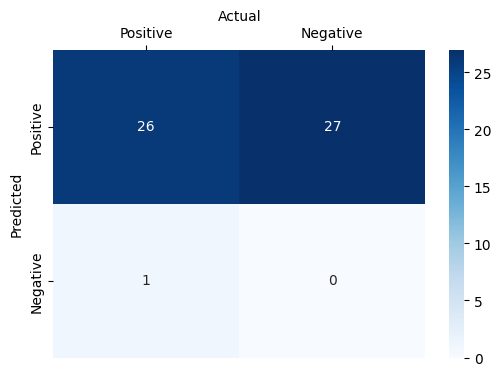

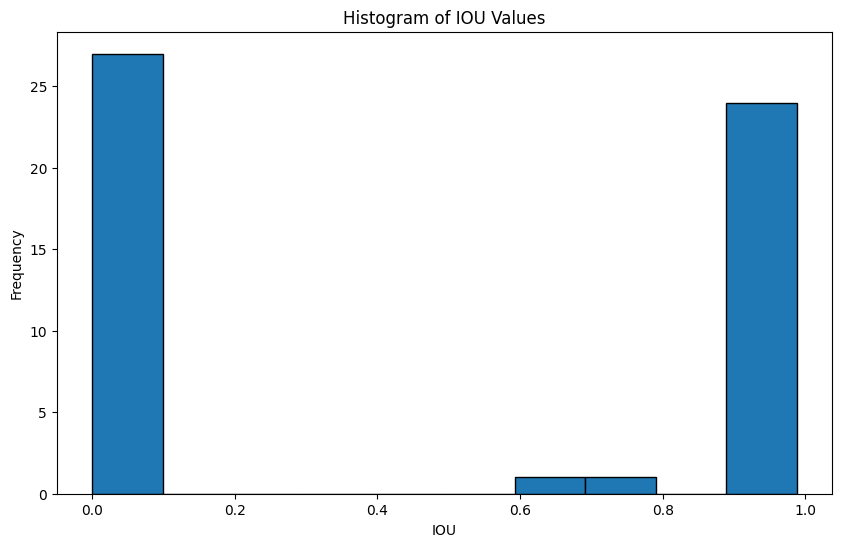

----------- Analysis for IMG_0044_p18 ----------- 



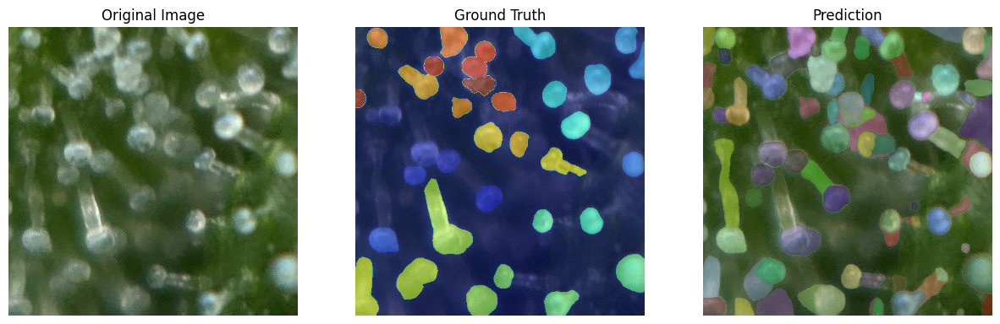

--- Precision = 0.34408602150537637, Recall = 0.9142857142857143---



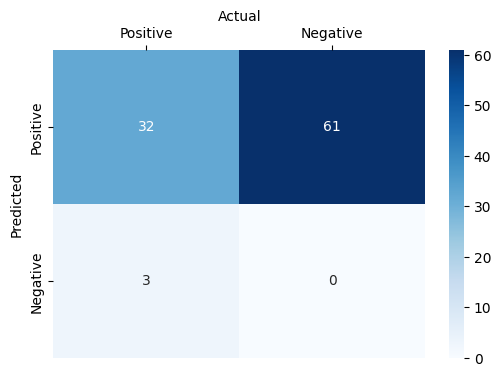

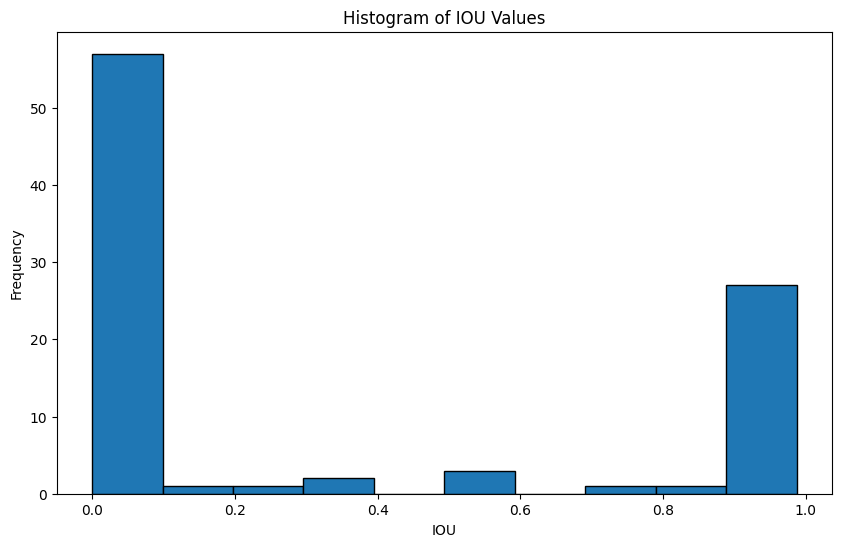

----------- Analysis for IMG_0044_p20 ----------- 



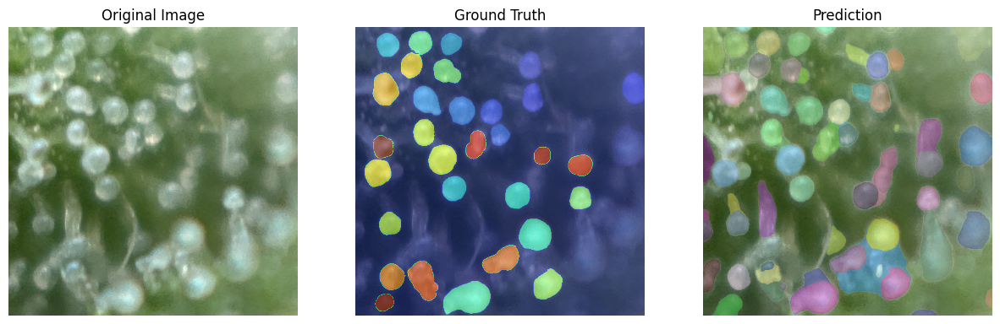

--- Precision = 0.410958904109589, Recall = 0.9375---



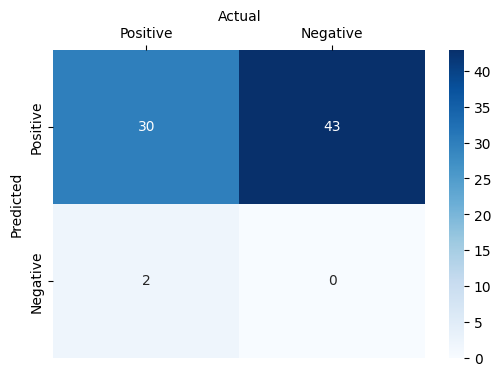

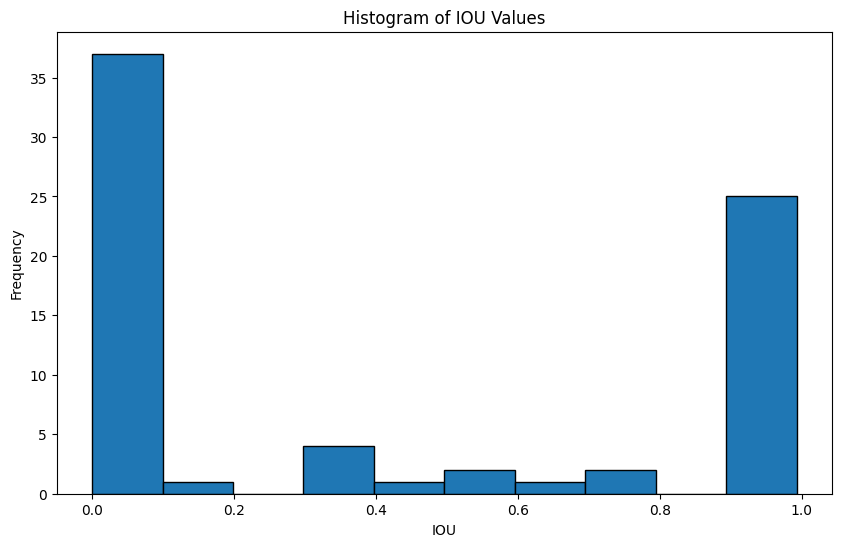

----------- Analysis for IMG_0044_p4 ----------- 



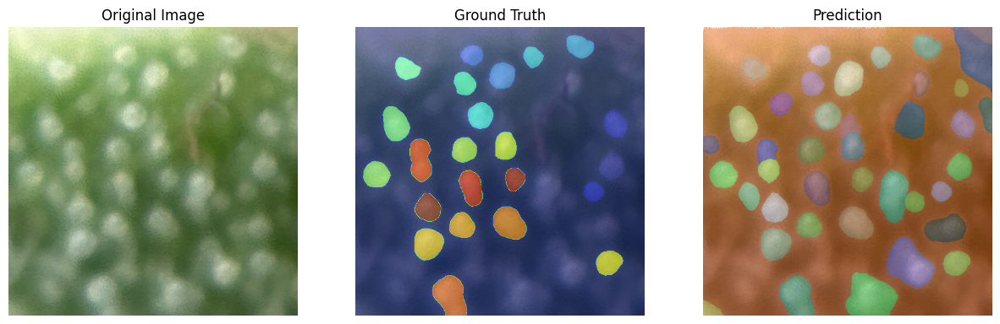

--- Precision = 0.5609756097560976, Recall = 1.0---



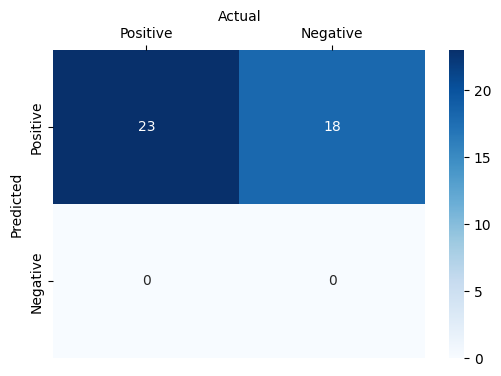

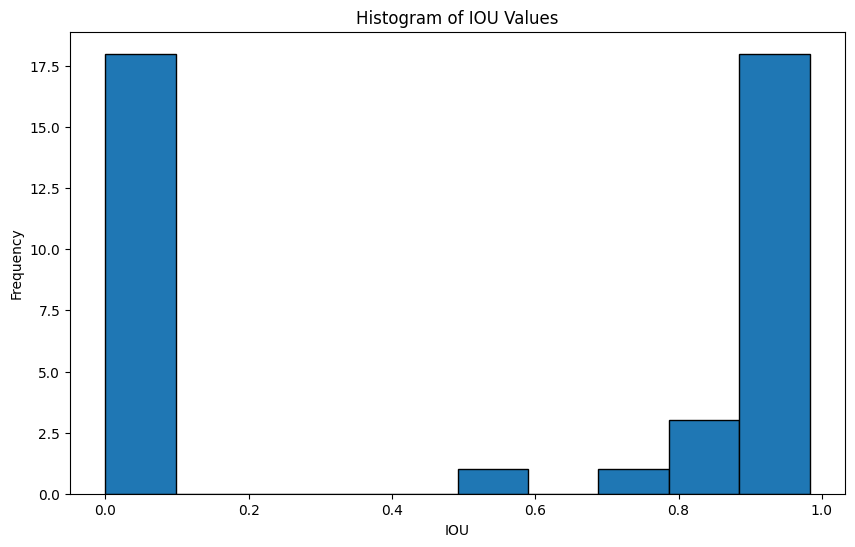

----------- Analysis for IMG_0044_p5 ----------- 



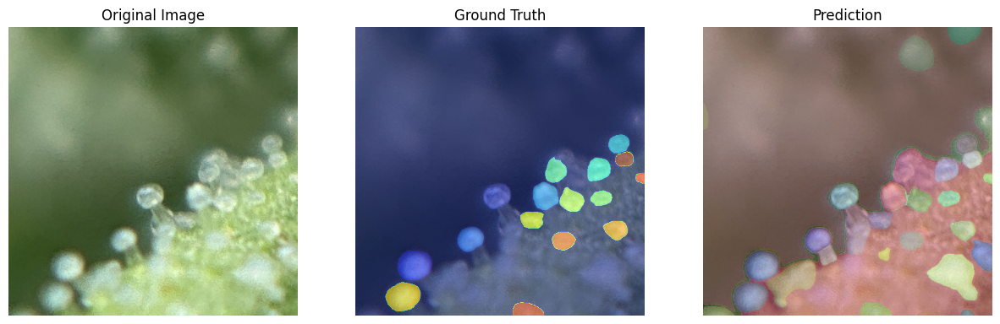

--- Precision = 0.5, Recall = 0.9375---



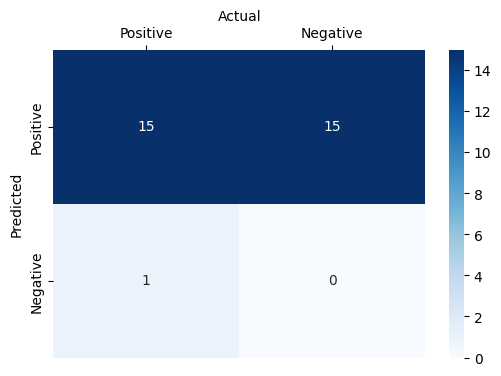

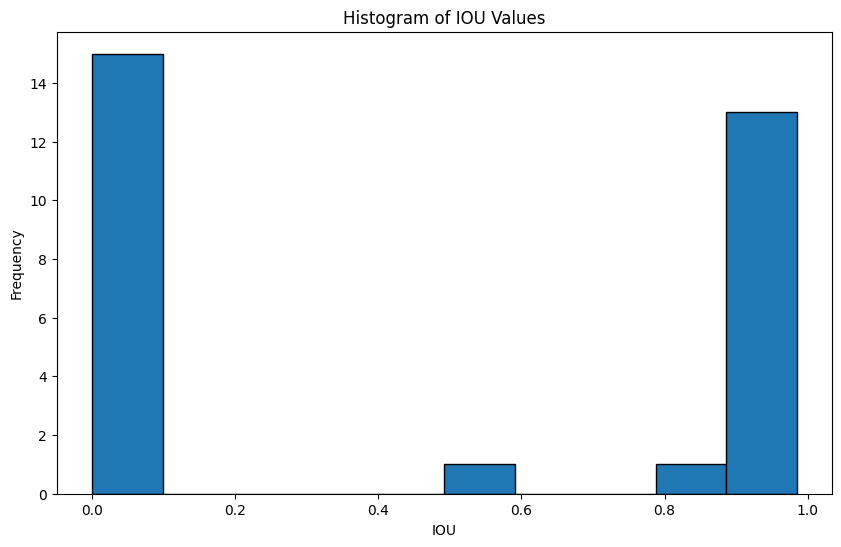

----------- Analysis for IMG_0044_p7 ----------- 



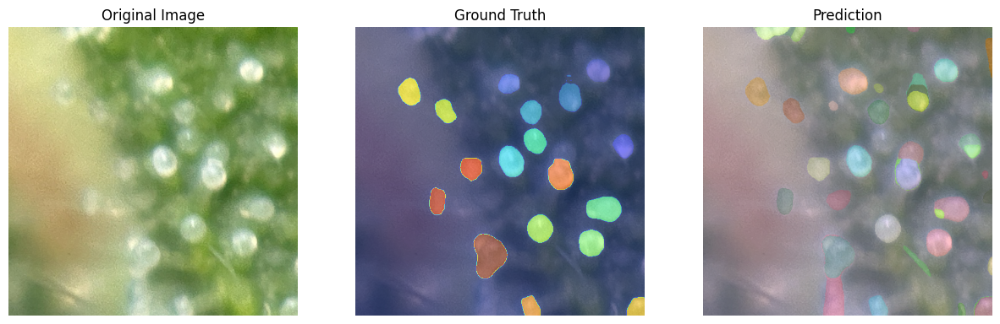

--- Precision = 0.425, Recall = 0.9444444444444444---



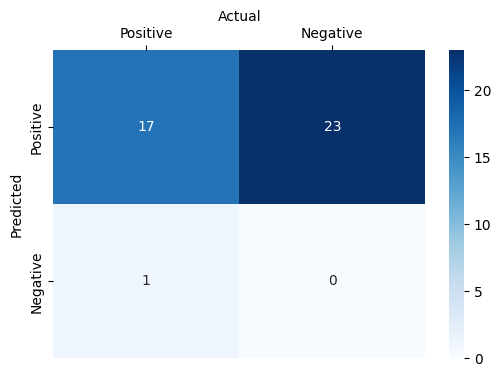

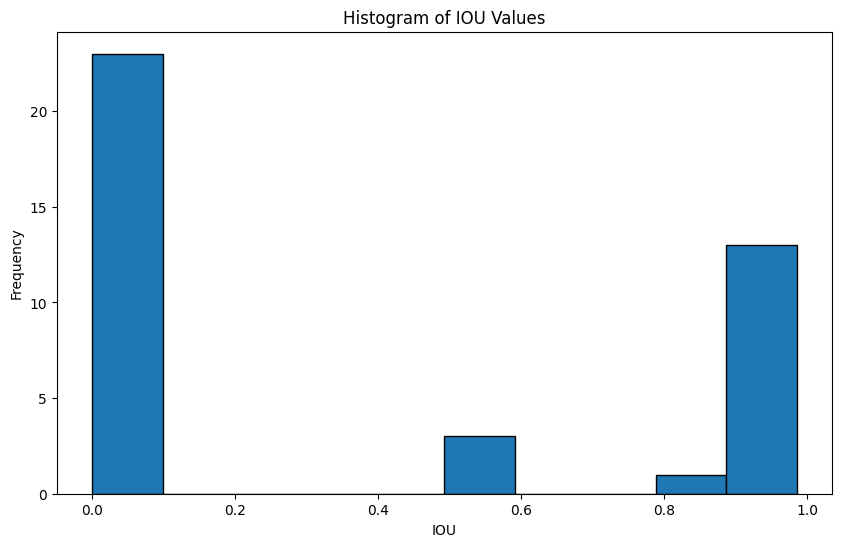

----------- Analysis for IMG_0045_p10 ----------- 



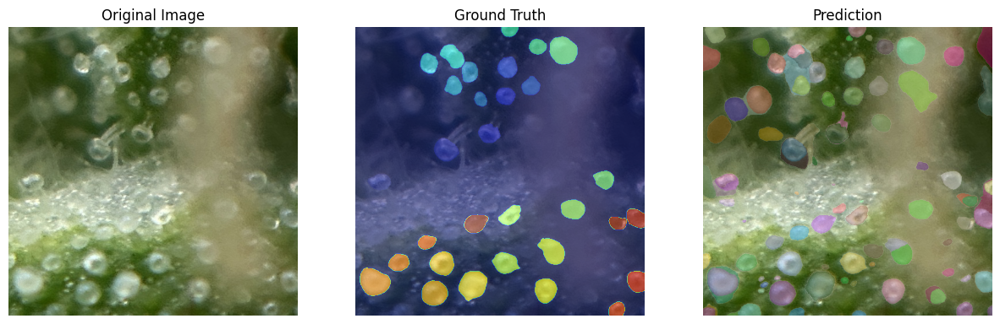

--- Precision = 0.32978723404255317, Recall = 1.0---



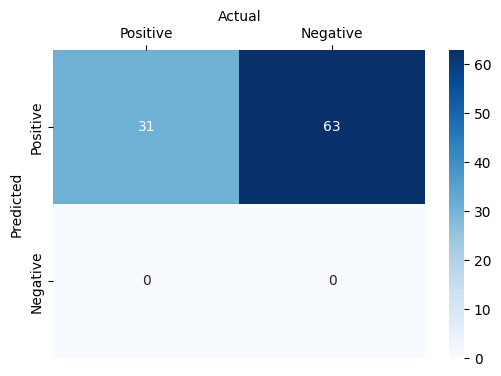

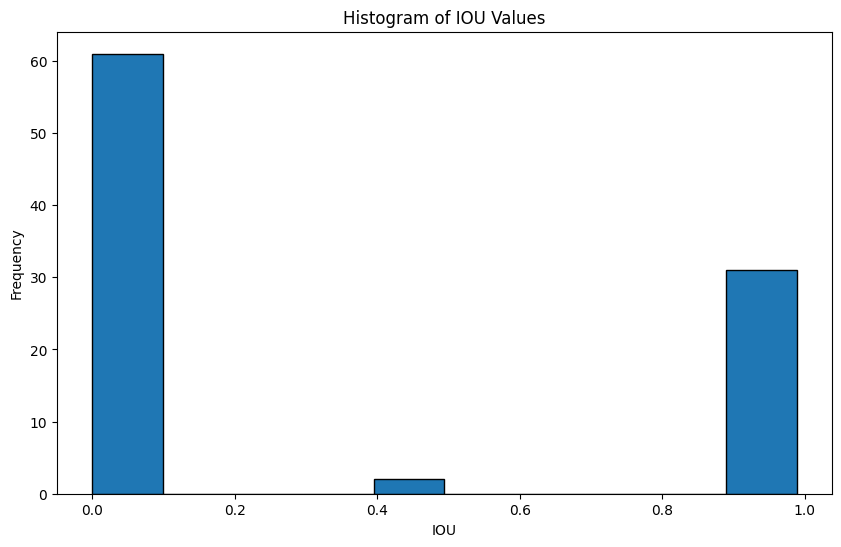

----------- Analysis for IMG_0045_p14 ----------- 



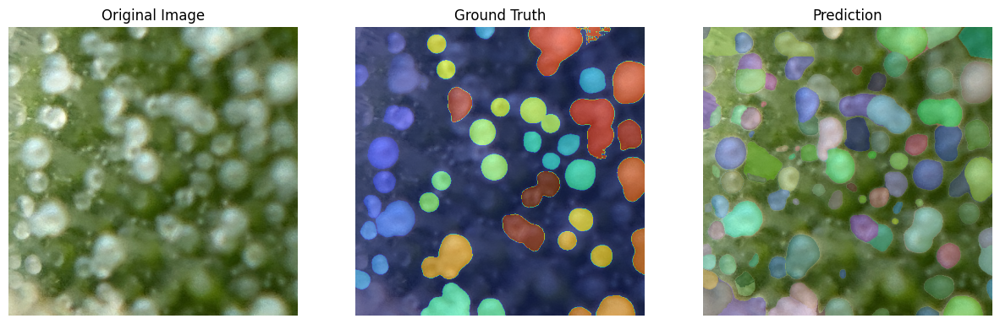

--- Precision = 0.3274336283185841, Recall = 0.8604651162790697---



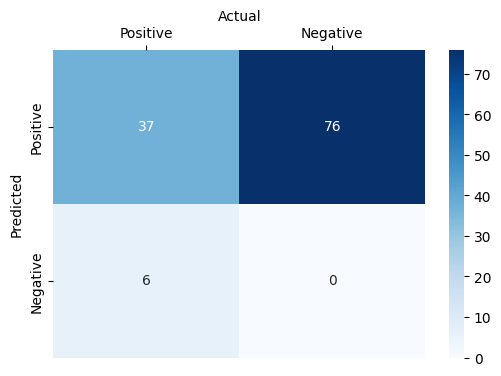

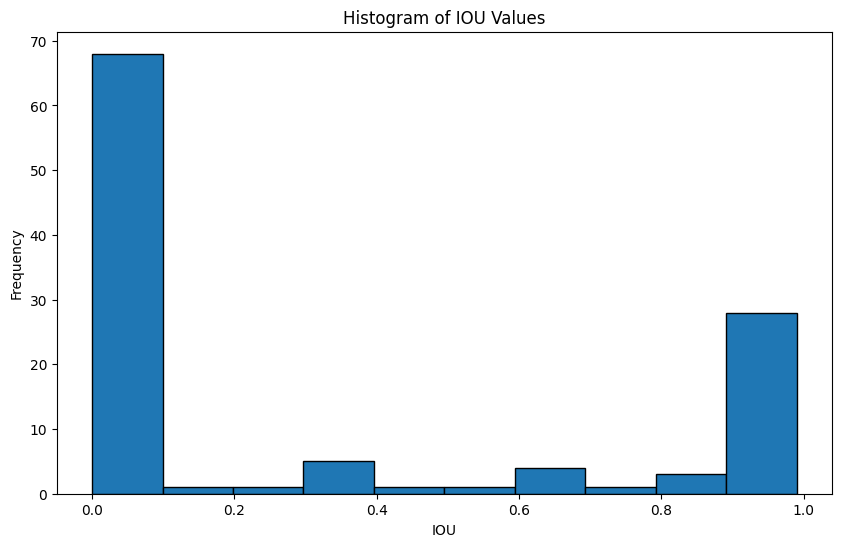

----------- Analysis for IMG_0045_p18 ----------- 



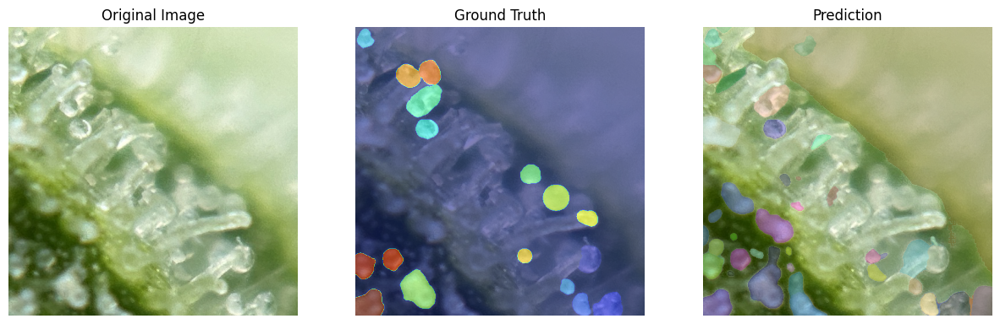

--- Precision = 0.2553191489361702, Recall = 0.7058823529411765---



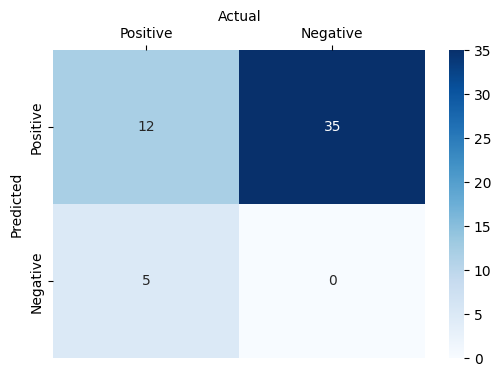

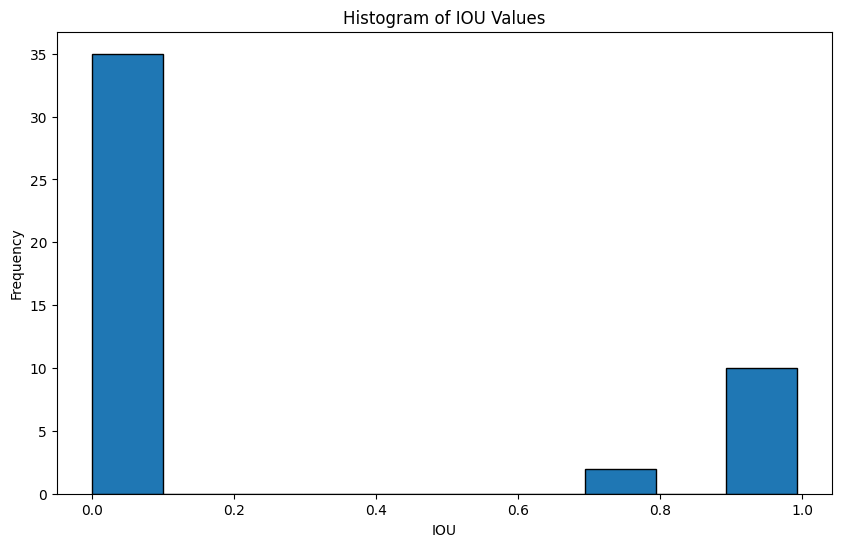

----------- Analysis for IMG_0045_p19 ----------- 



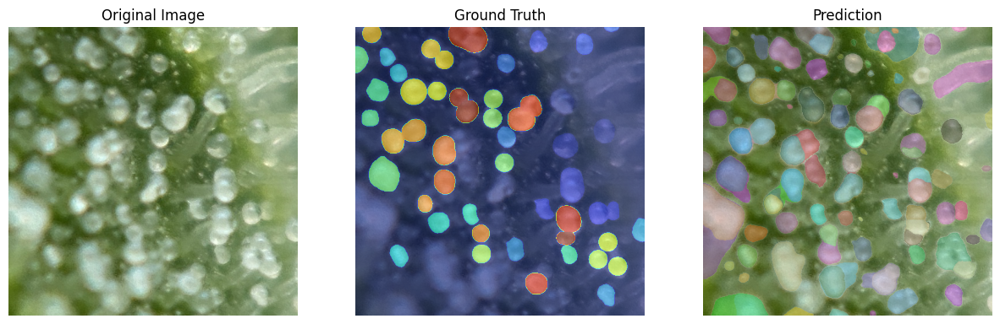

--- Precision = 0.4036697247706422, Recall = 0.88---



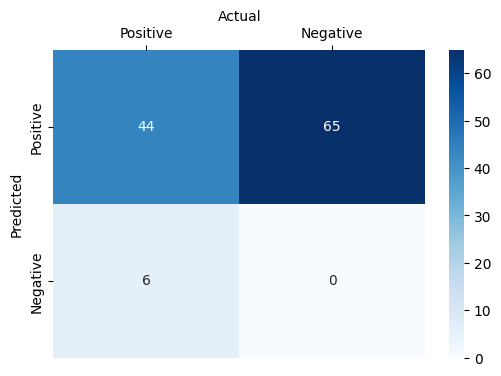

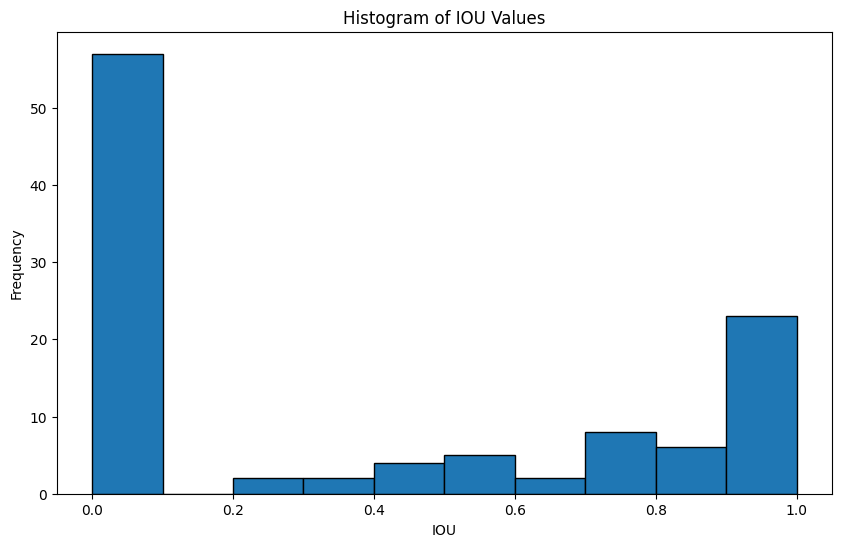

----------- Analysis for IMG_0045_p28 ----------- 



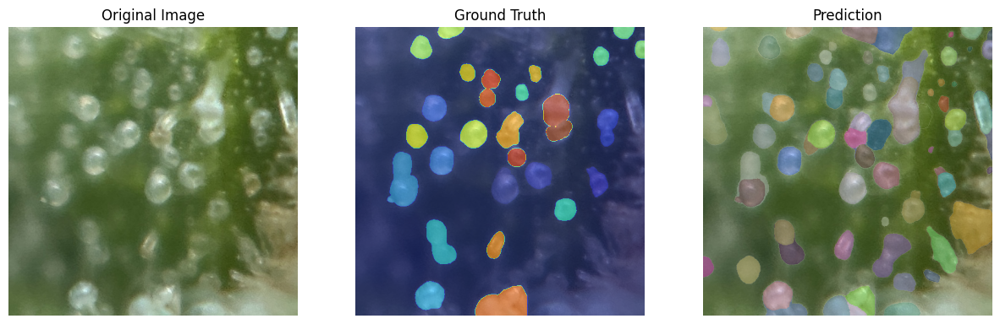

--- Precision = 0.34210526315789475, Recall = 0.9285714285714286---



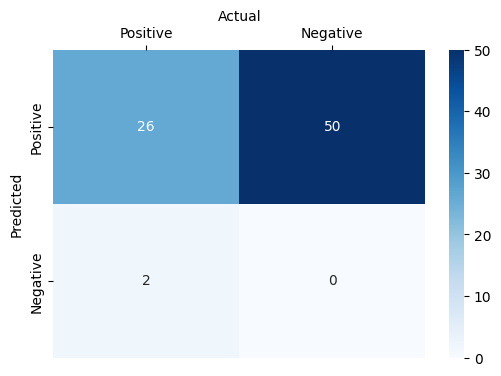

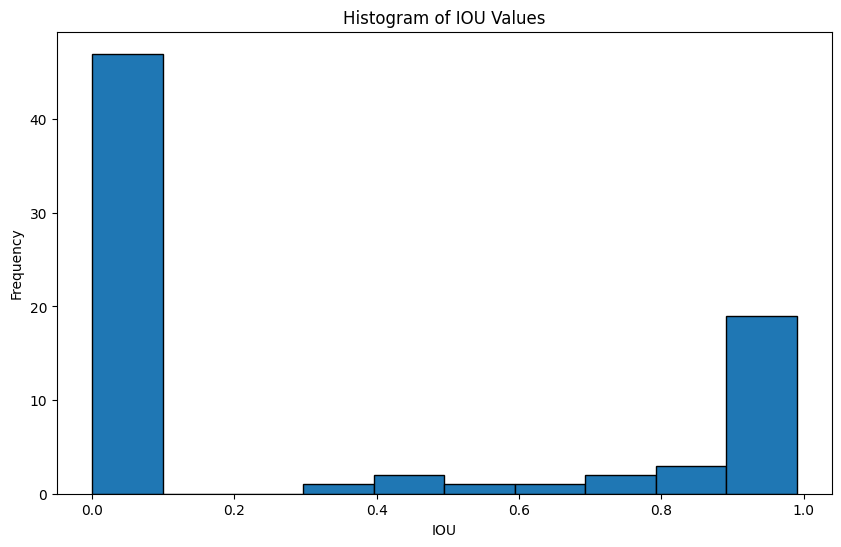

----------- Analysis for IMG_0045_p34 ----------- 



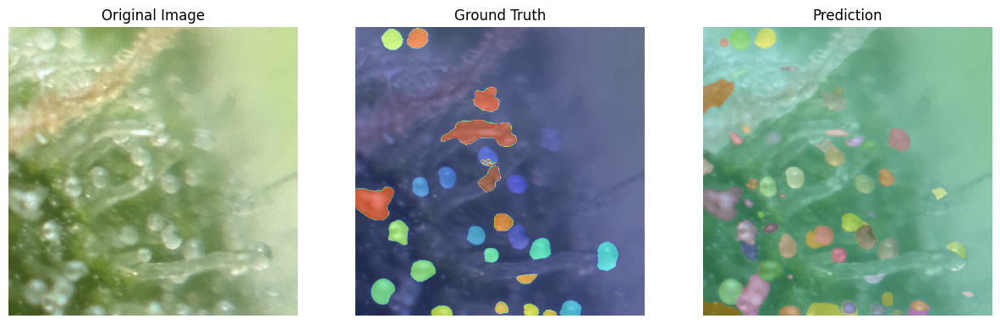

--- Precision = 0.359375, Recall = 0.8846153846153846---



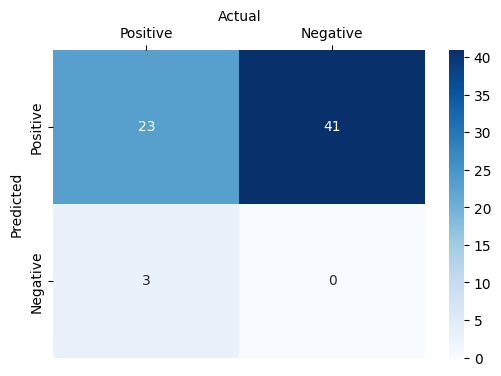

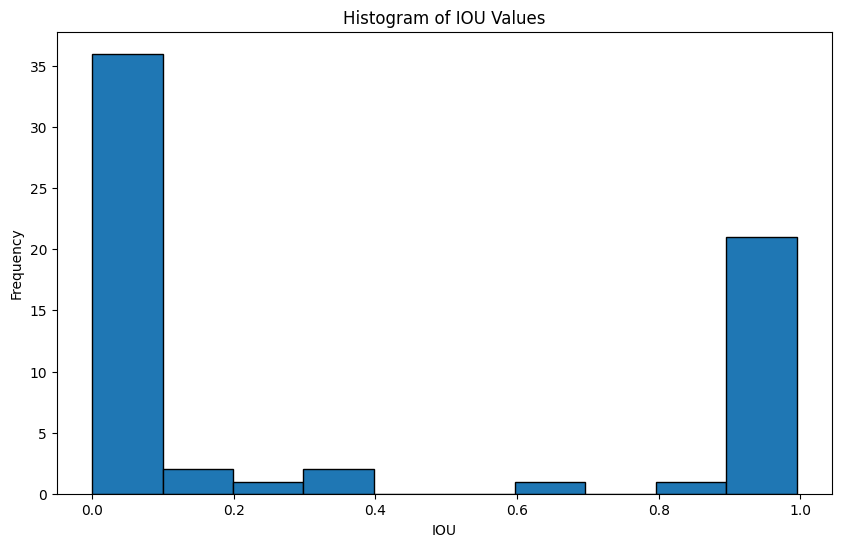

----------- Analysis for IMG_0045_p35 ----------- 



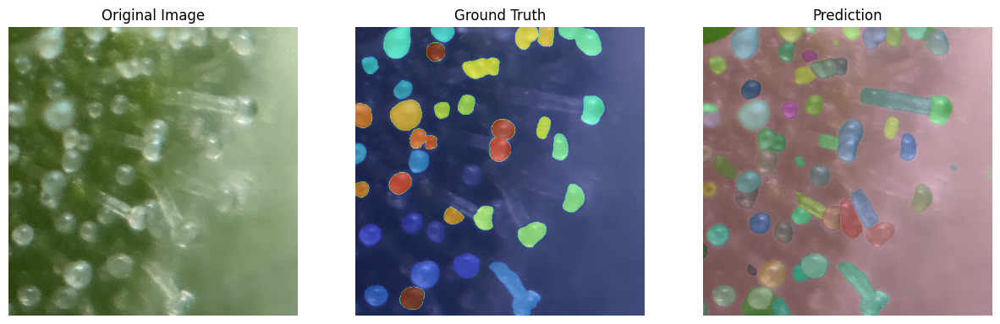

--- Precision = 0.4925373134328358, Recall = 0.8918918918918919---



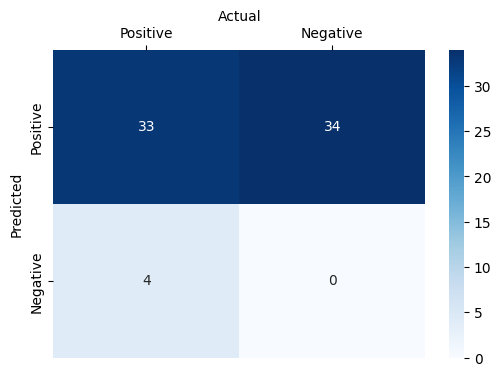

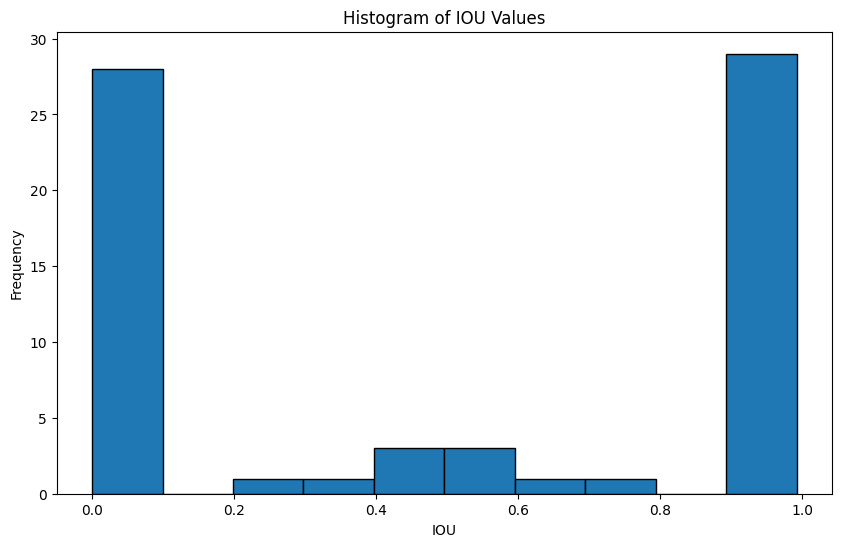

----------- Analysis for IMG_0045_p9 ----------- 



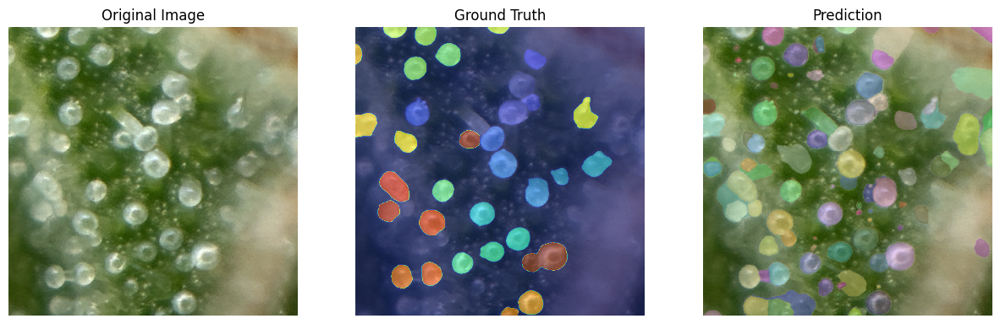

--- Precision = 0.30275229357798167, Recall = 1.0---



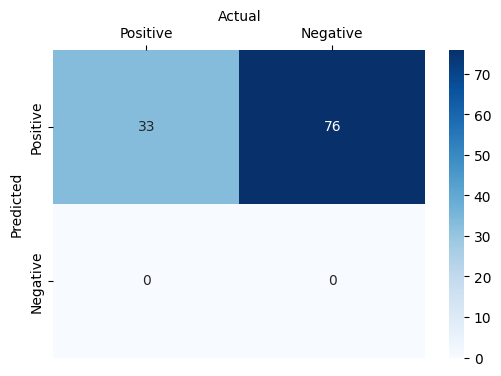

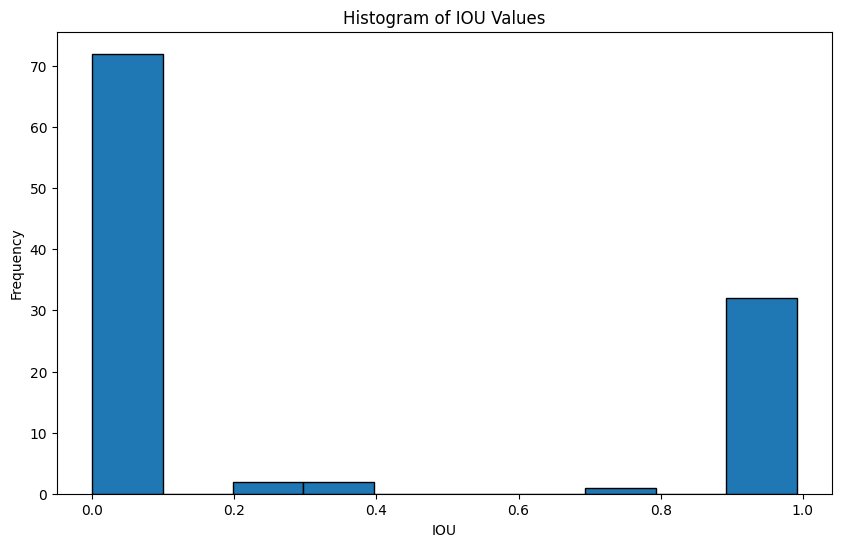

----------- Analysis for IMG_0061_p11 ----------- 



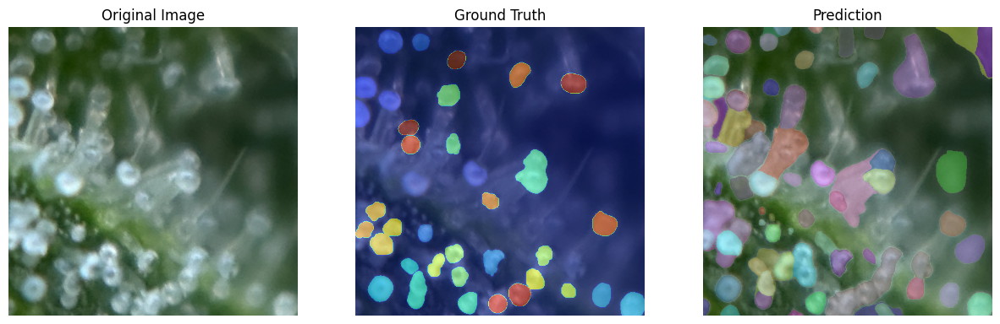

--- Precision = 0.2987012987012987, Recall = 0.6216216216216216---



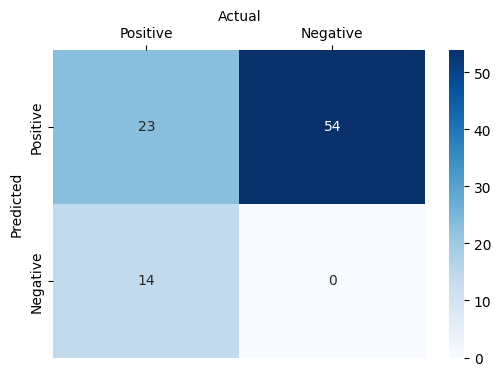

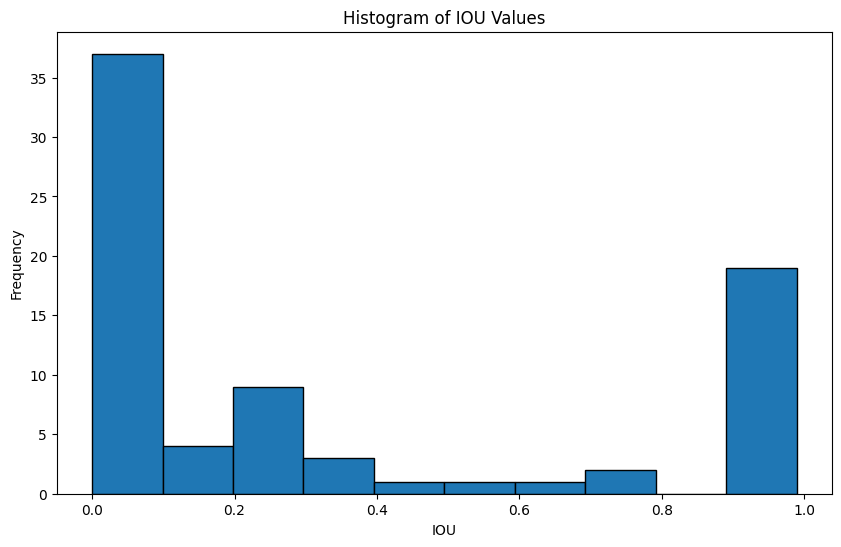

----------- Analysis for IMG_0061_p12 ----------- 



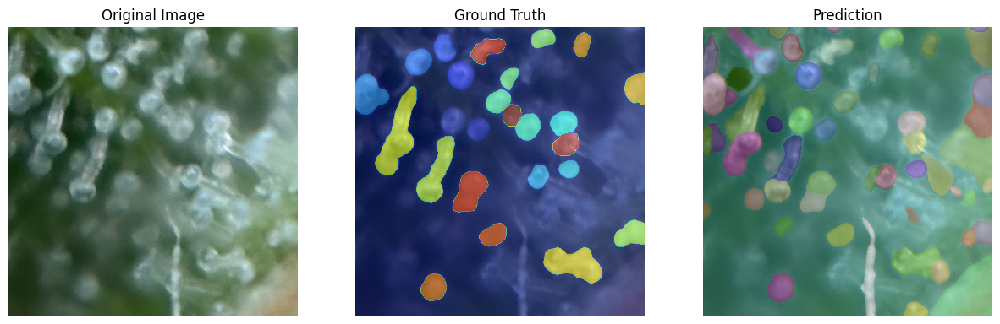

--- Precision = 0.35, Recall = 0.84---



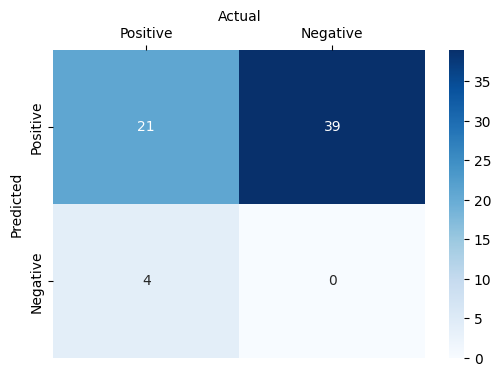

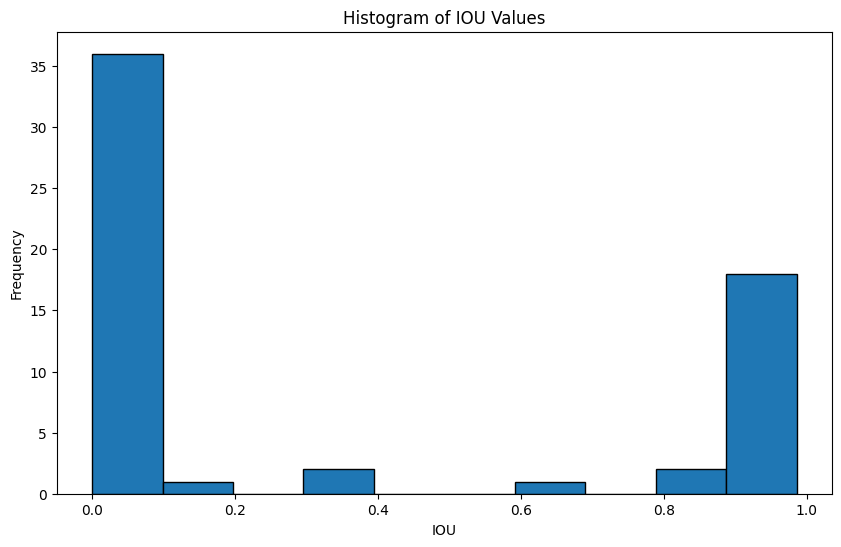

----------- Analysis for IMG_0061_p16 ----------- 



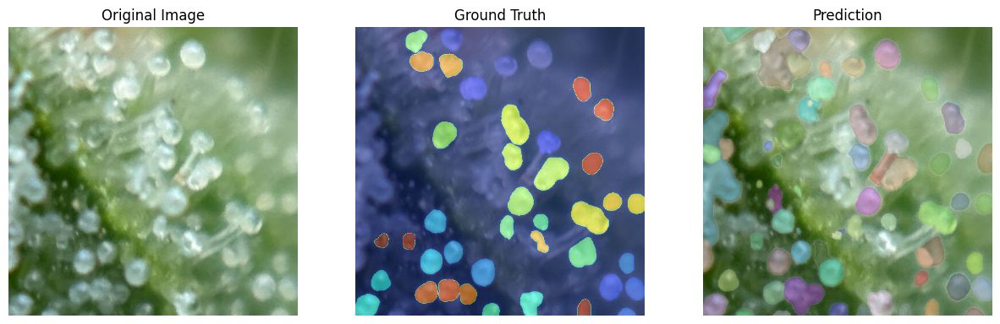

--- Precision = 0.47297297297297297, Recall = 0.8536585365853658---



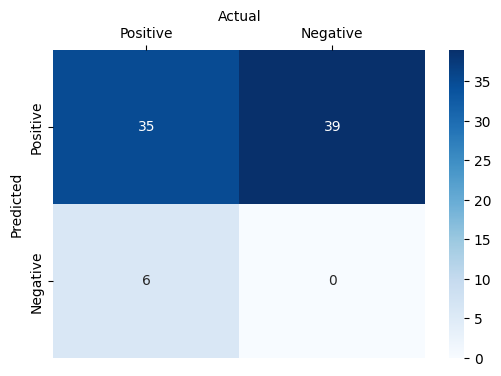

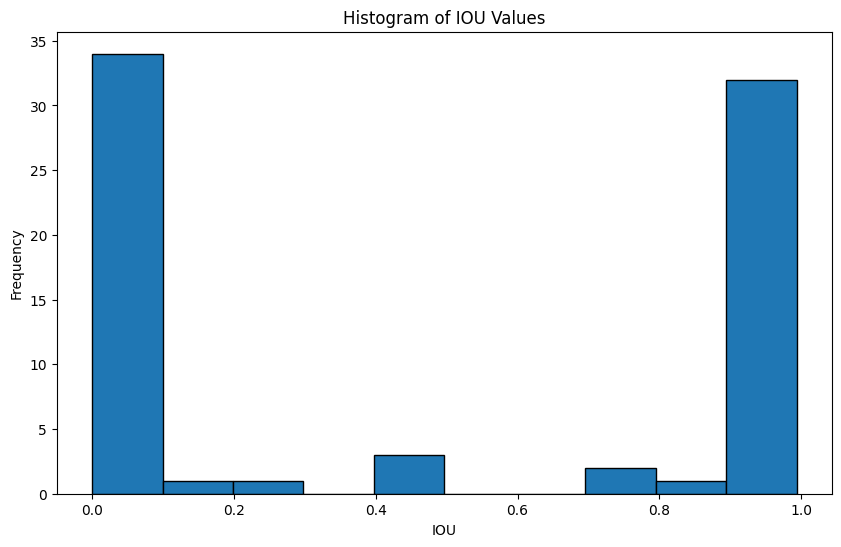

----------- Analysis for IMG_0061_p3 ----------- 



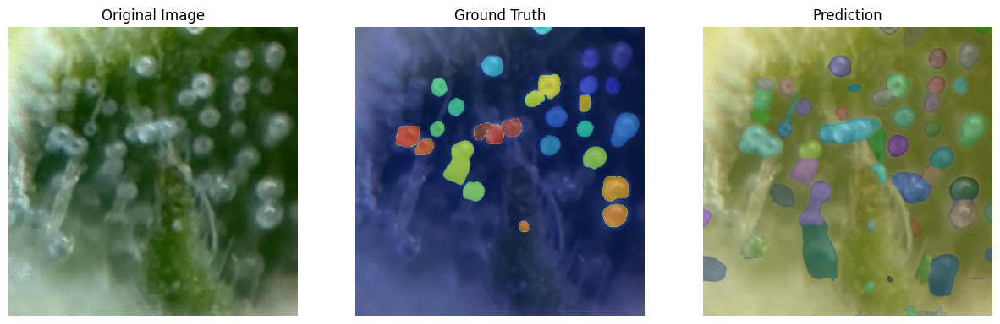

--- Precision = 0.375, Recall = 0.7777777777777778---



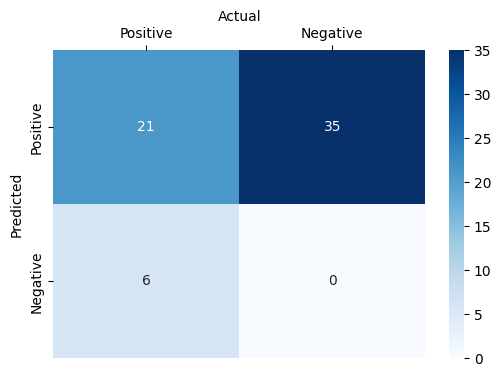

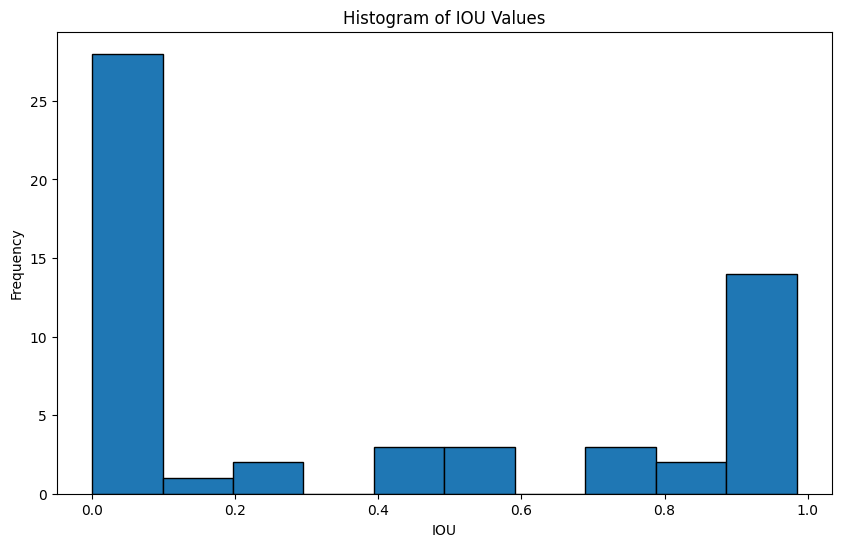

----------- Analysis for IMG_0061_p7 ----------- 



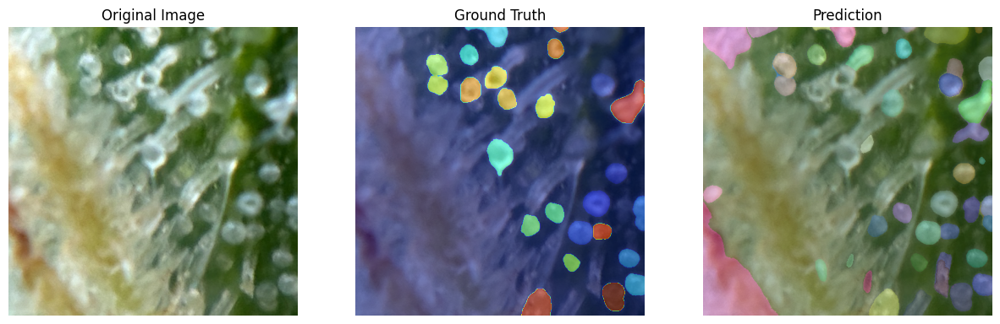

--- Precision = 0.42, Recall = 0.84---



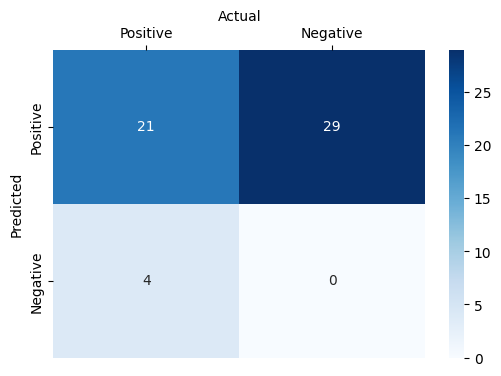

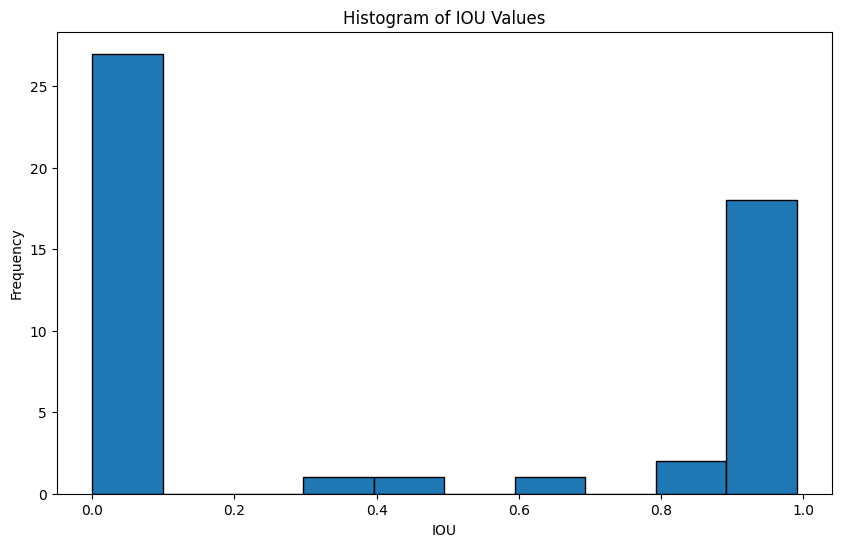

----------- Analysis for IMG_0062_p11 ----------- 



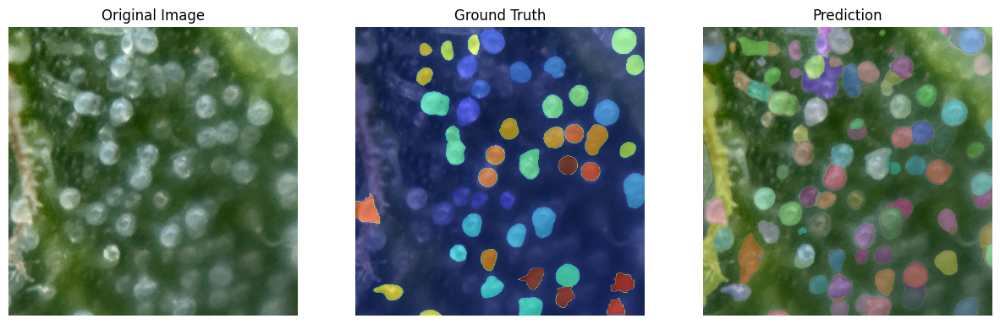

--- Precision = 0.44660194174757284, Recall = 0.9583333333333334---



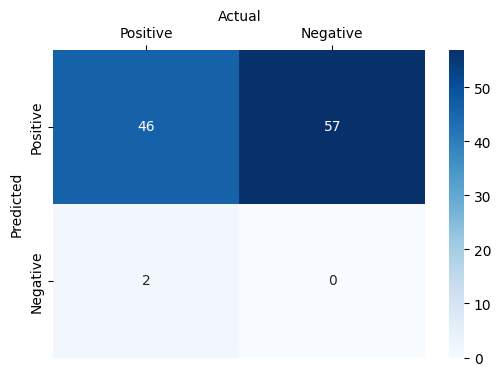

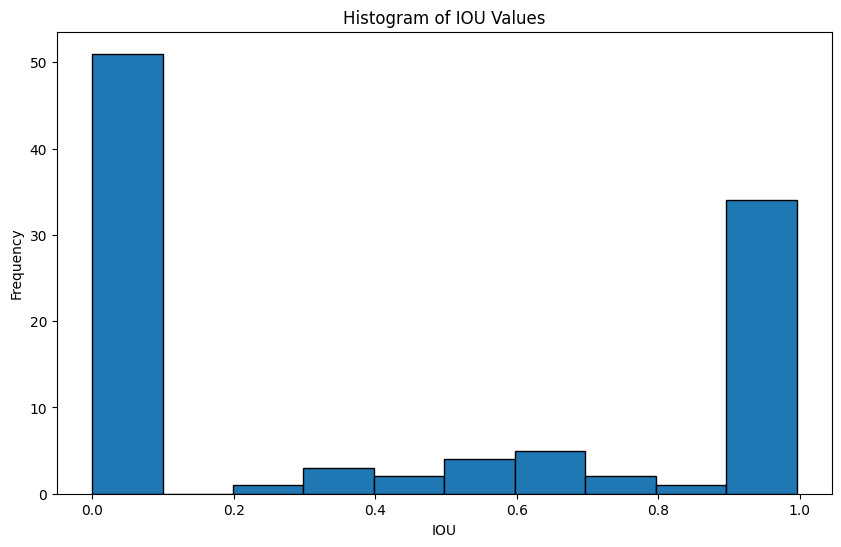

----------- Analysis for IMG_0072_p11 ----------- 



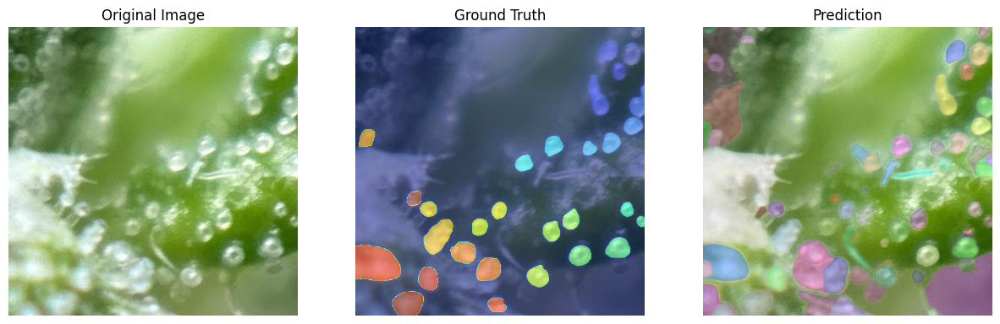

--- Precision = 0.3611111111111111, Recall = 0.896551724137931---



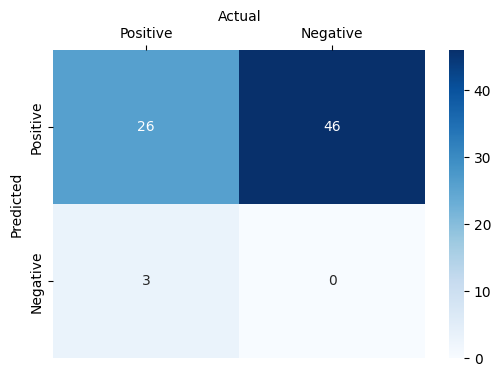

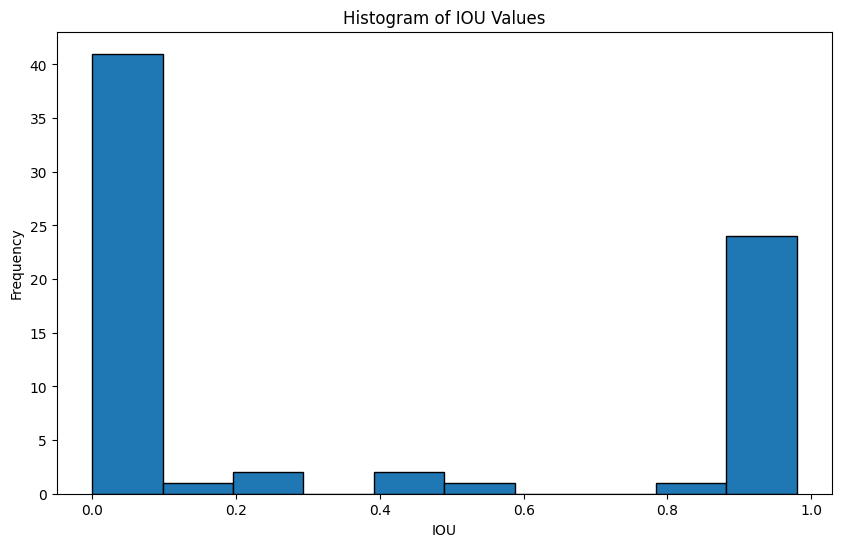

----------- Analysis for IMG_0072_p12 ----------- 



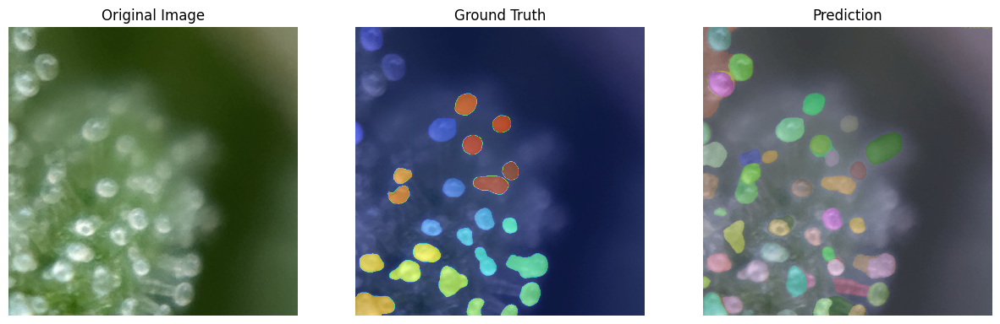

--- Precision = 0.45454545454545453, Recall = 0.9615384615384616---



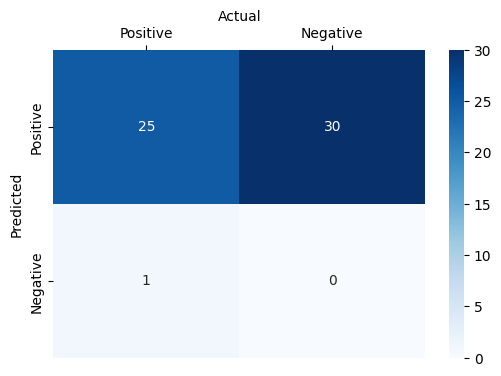

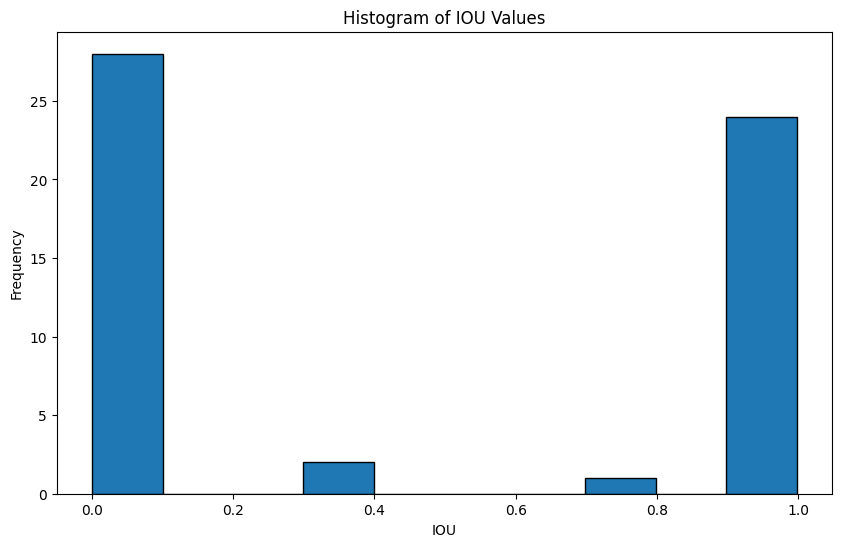

----------- Analysis for IMG_0072_p14 ----------- 



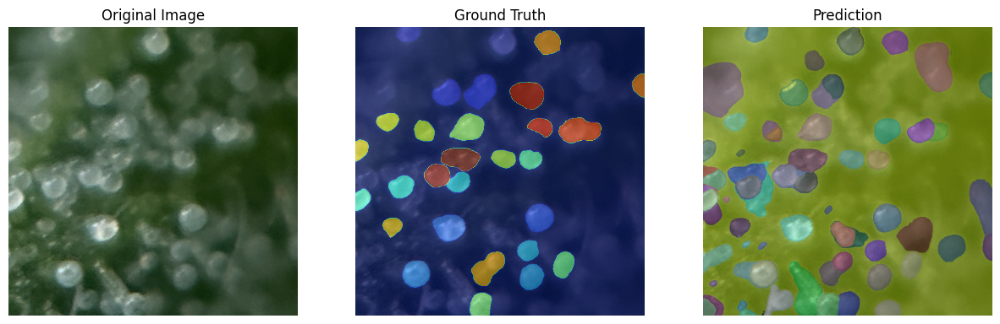

--- Precision = 0.391304347826087, Recall = 0.9---



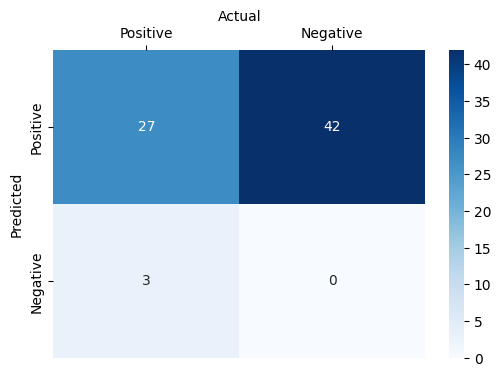

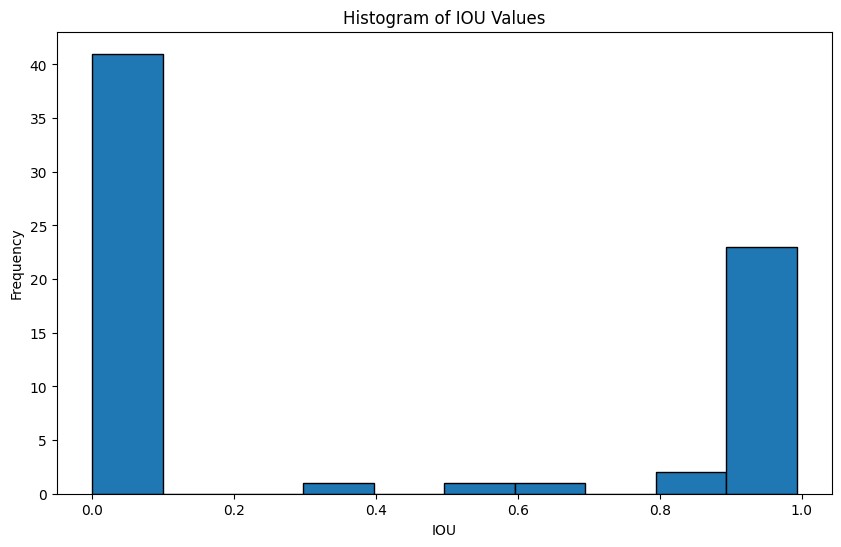

----------- Analysis for IMG_0072_p25 ----------- 



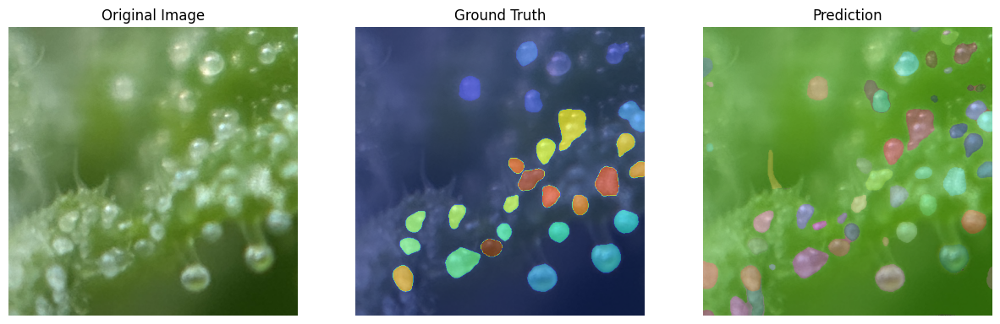

--- Precision = 0.45614035087719296, Recall = 0.9629629629629629---



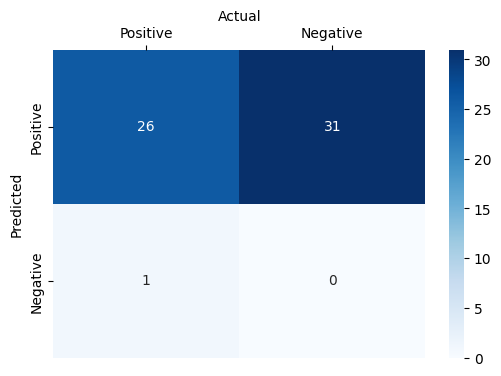

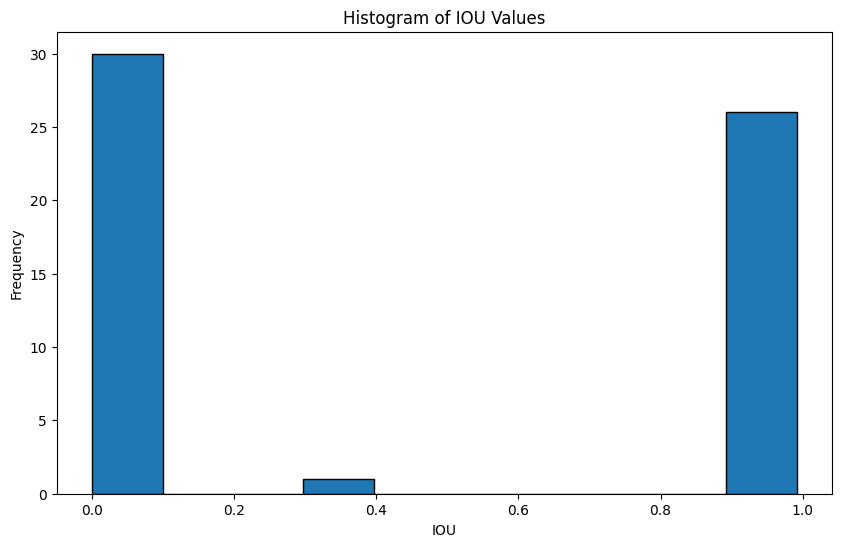

----------- Analysis for IMG_9979_p12 ----------- 



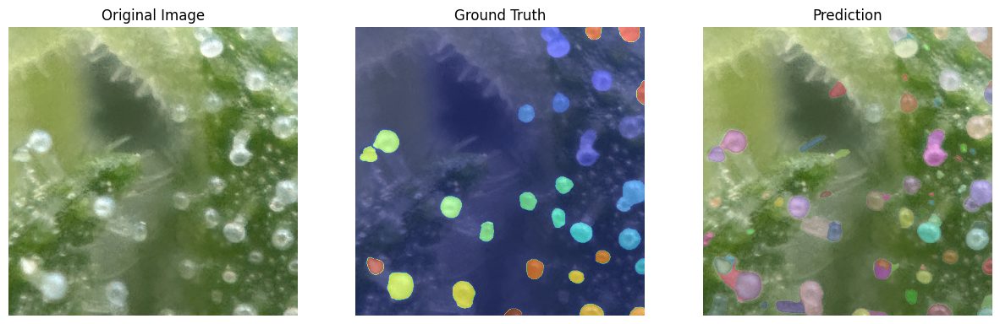

--- Precision = 0.35802469135802467, Recall = 1.0---



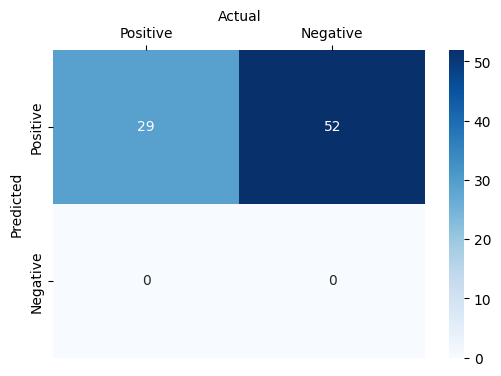

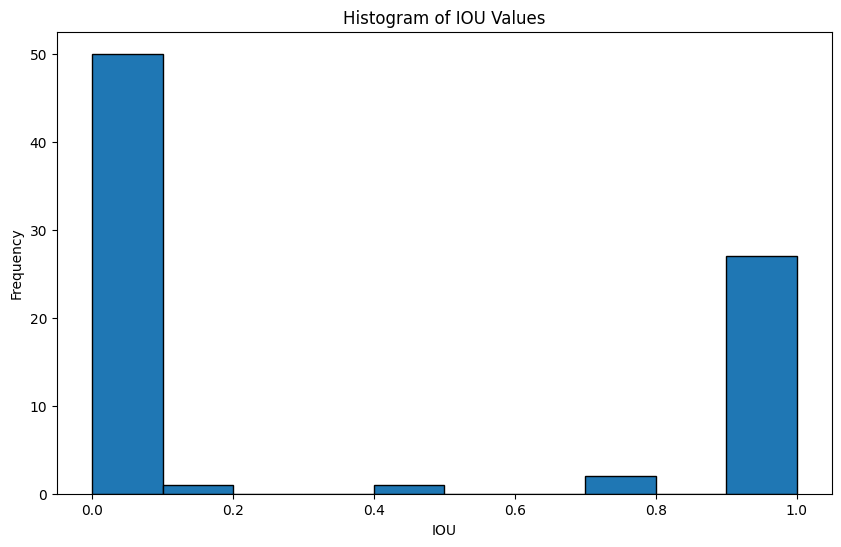

----------- Analysis for IMG_9979_p13 ----------- 



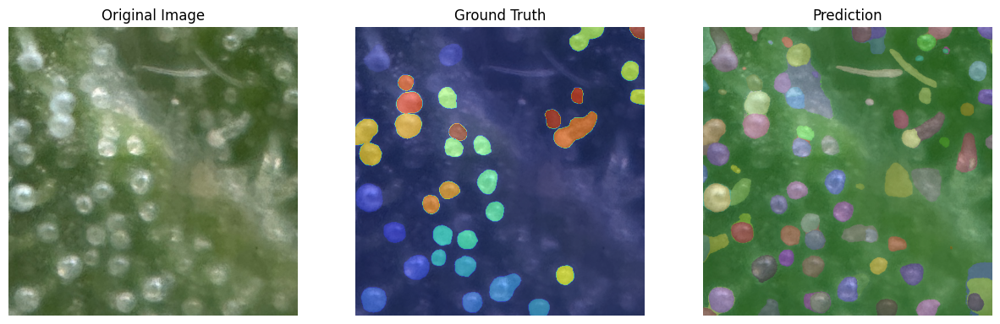

--- Precision = 0.336734693877551, Recall = 0.9705882352941176---



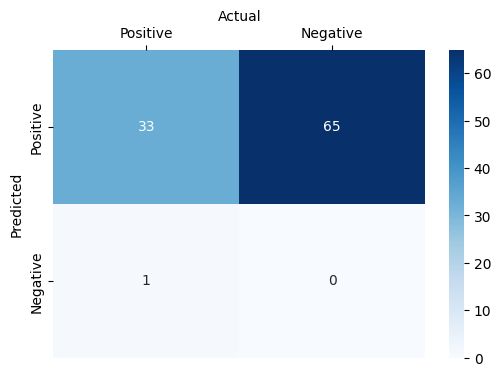

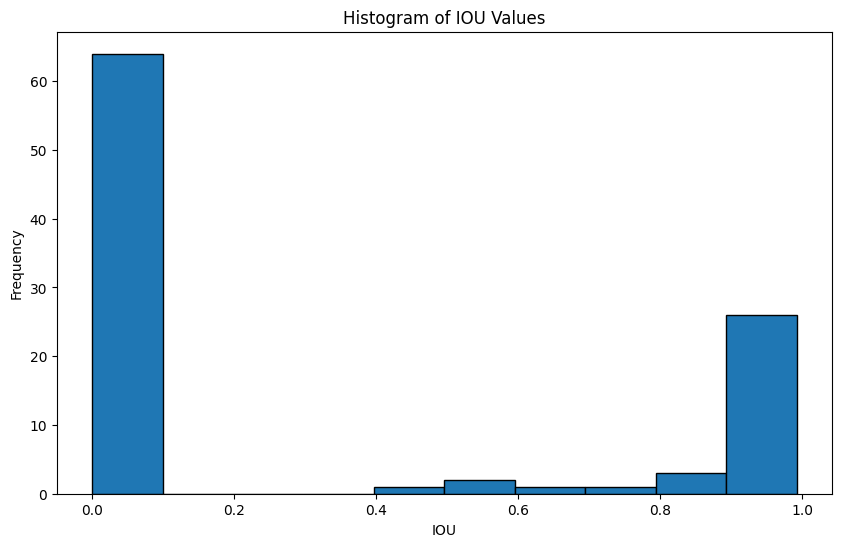

----------- Analysis for IMG_9979_p19 ----------- 



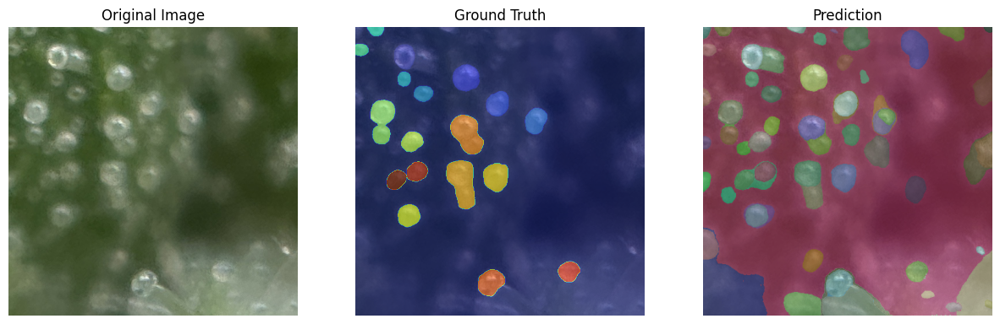

--- Precision = 0.2857142857142857, Recall = 0.9473684210526315---



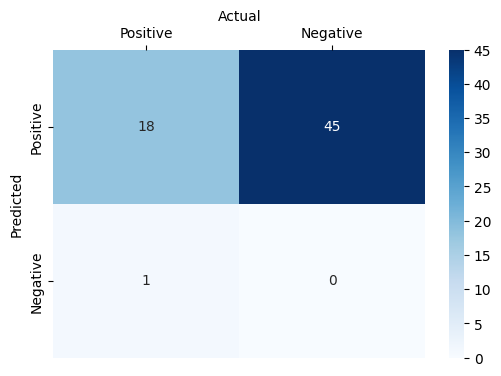

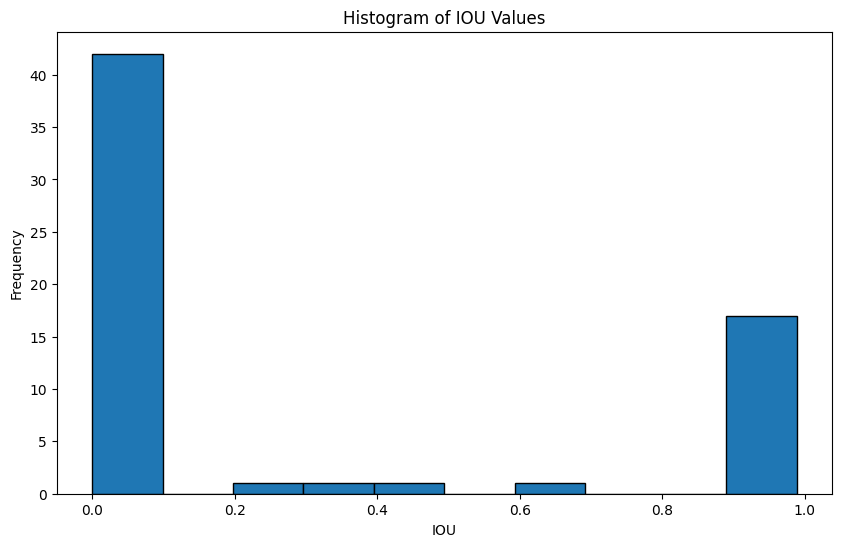

----------- Analysis for IMG_9979_p26 ----------- 



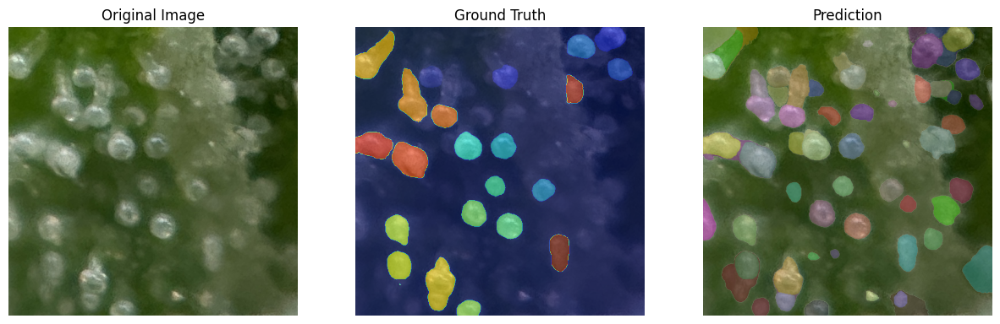

--- Precision = 0.31343283582089554, Recall = 0.9545454545454546---



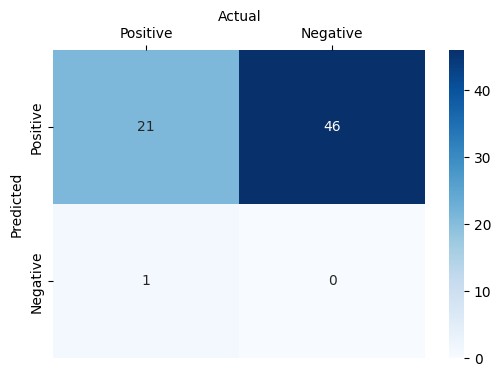

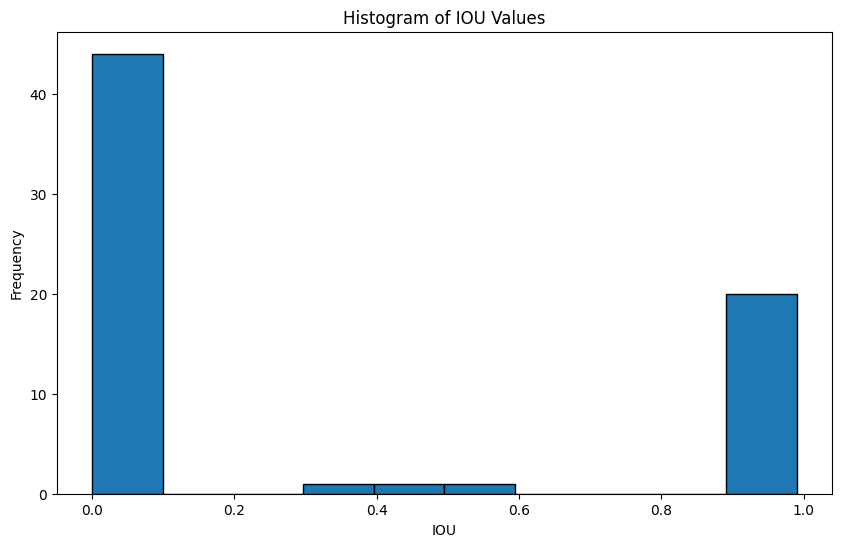

----------- Analysis for IMG_9998_p14 ----------- 



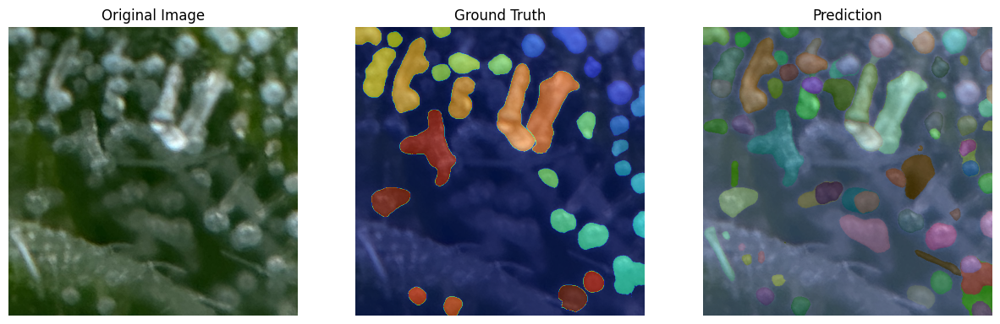

--- Precision = 0.4358974358974359, Recall = 1.0---



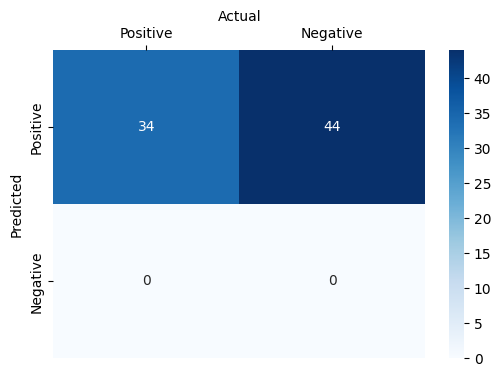

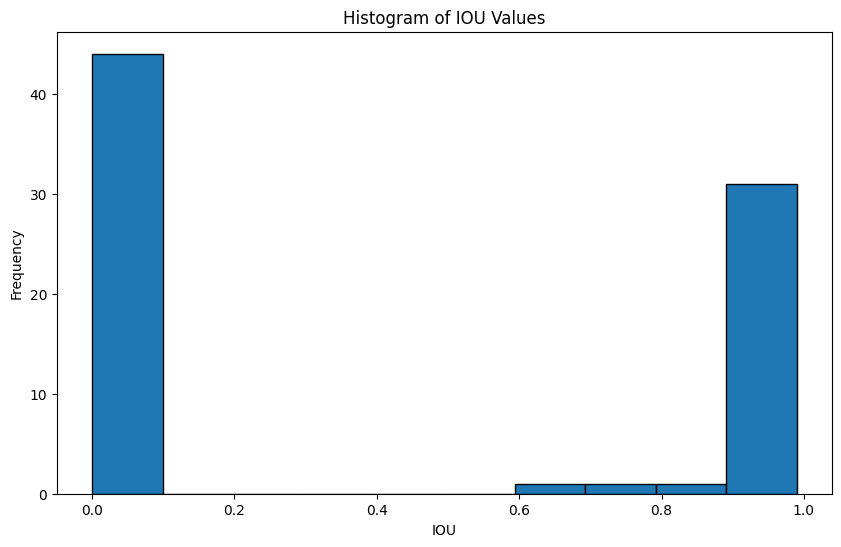

----------- Analysis for IMG_9998_p18 ----------- 



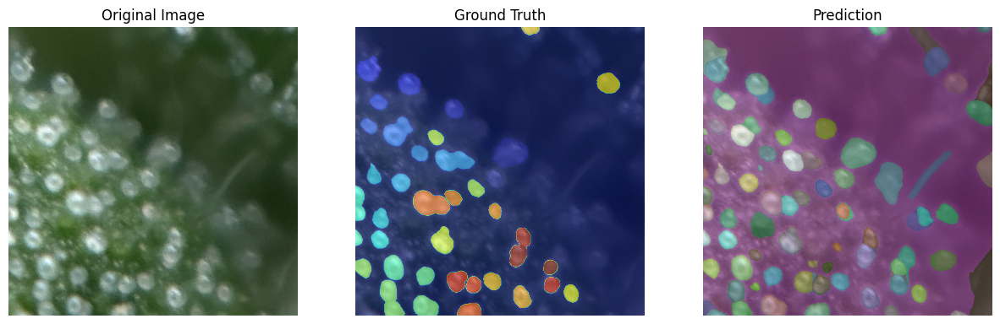

--- Precision = 0.45348837209302323, Recall = 1.0---



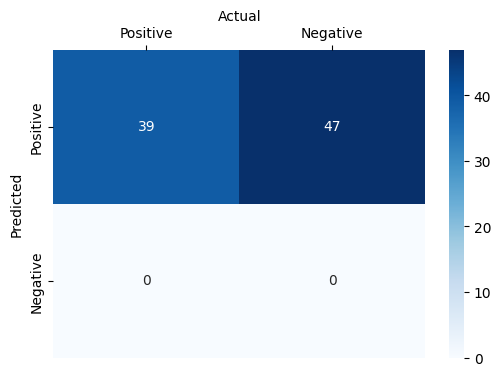

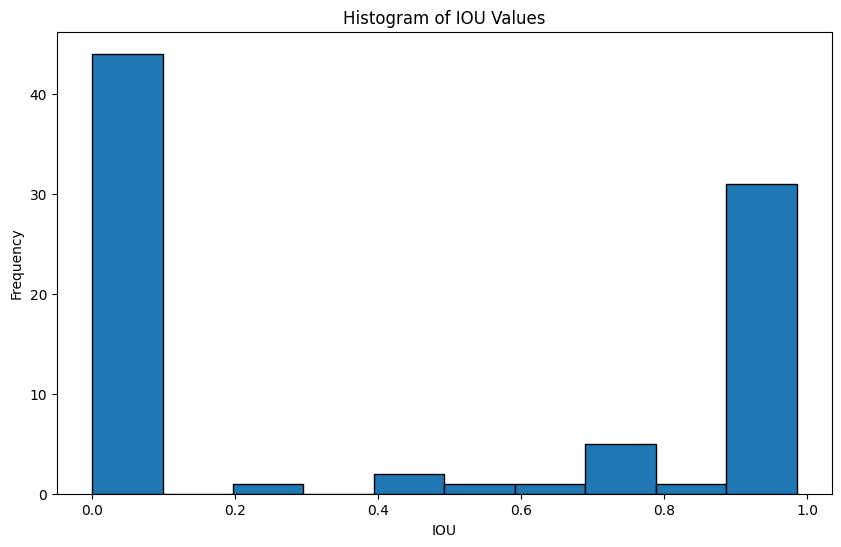

----------- Analysis for IMG_9998_p19 ----------- 



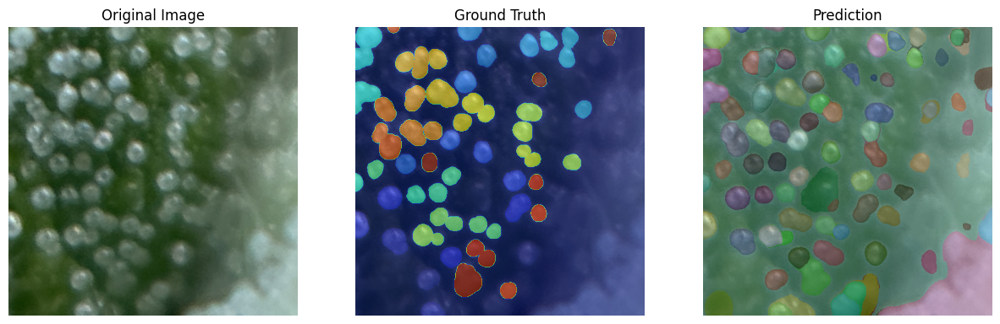

--- Precision = 0.5376344086021505, Recall = 0.819672131147541---



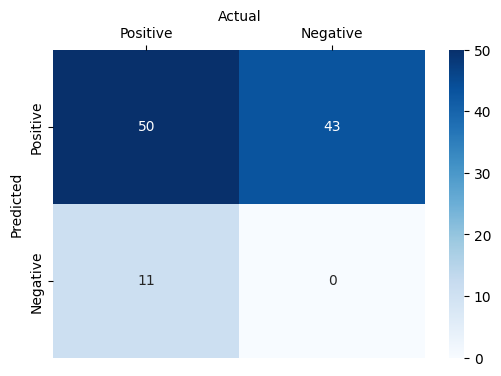

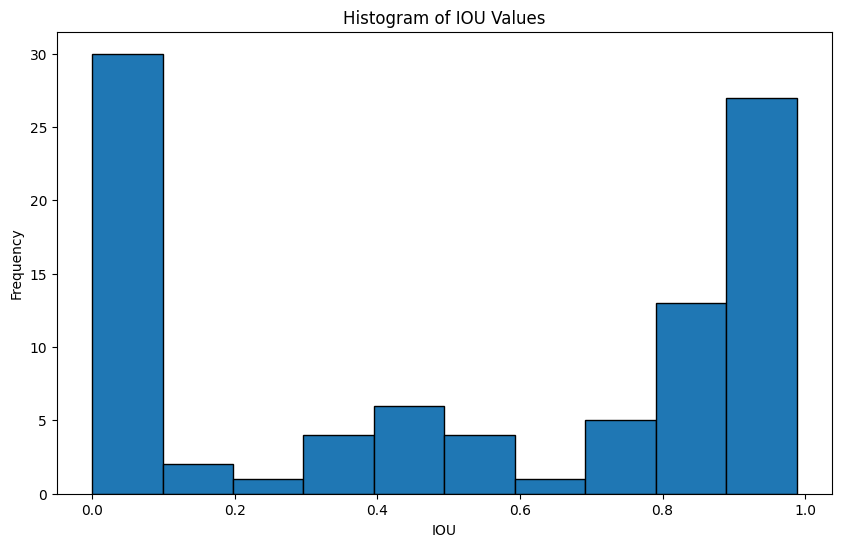

----------- Analysis for IMG_9998_p32 ----------- 



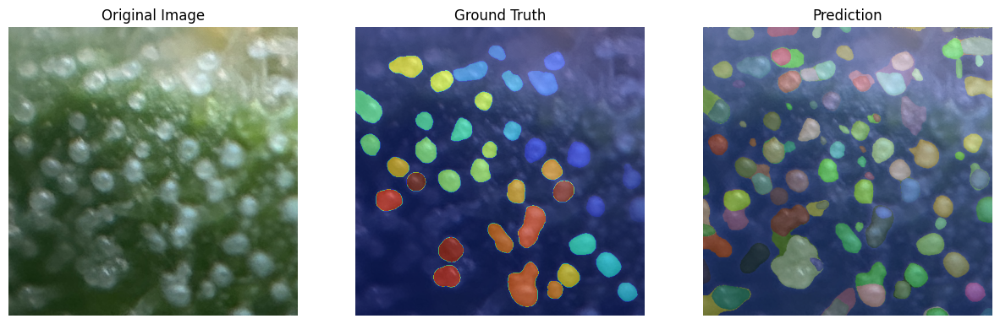

--- Precision = 0.34285714285714286, Recall = 0.9473684210526315---



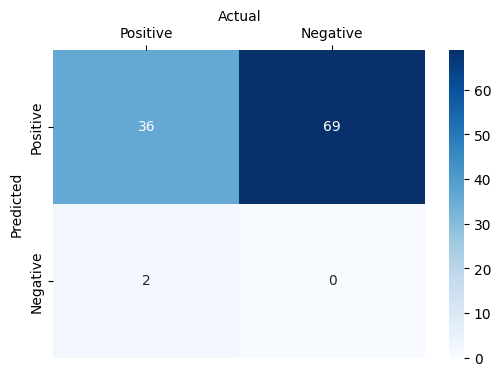

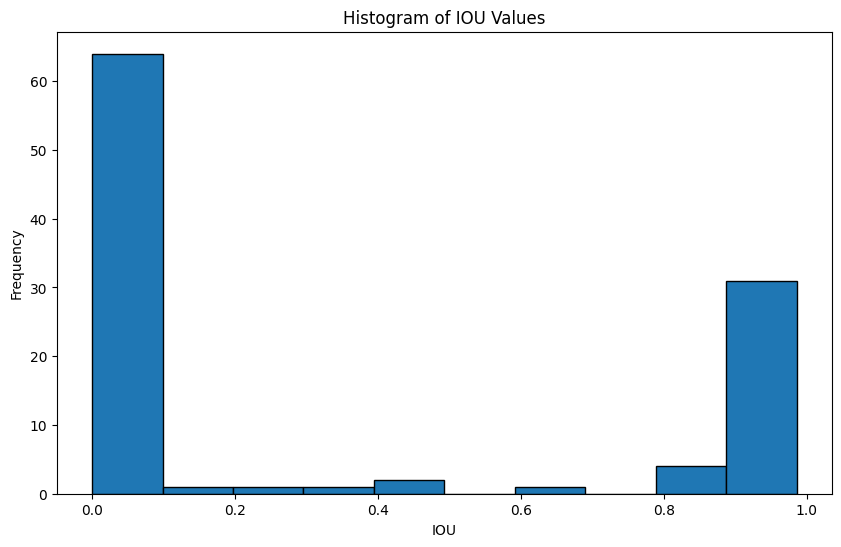

In [ ]:
for sample in ground_truth.keys():
  print(f"----------- Analysis for {sample} ----------- \n")
  plot_masks(ground_truth[sample], SAM_pred[sample])
  precision, recall, (TPs, FPs, FNs), iou_values = calculate_precision_recall_per_segment(ground_truth[sample], SAM_pred[sample], iou_threshold=0.5)
  print(f"--- Precision = {precision}, Recall = {recall}---\n")
  plot_confusion_matrix(TPs, FPs, FNs)
  plot_iou_histogram(iou_values)

In [ ]:
def plot_avg_precision_recall_curve(gt_dict, pred_dict):
    # Define a range of IOU thresholds
    iou_thresholds = np.linspace(0.3, 1.0, 10)  # Vary IOU from 0.3 to 1.0

    # Initialize lists to store precision and recall values
    precision_values = []
    recall_values = []

    # Iterate through the thresholds and calculate precision and recall
    for iou_thresh in iou_thresholds:
        precision, recall = calculate_average_precision_recall(gt_dict, pred_dict, iou_thresh)
        precision_values.append(precision)
        recall_values.append(recall)

    # Plot the precision-recall curve
    plt.figure(figsize=(10, 7))
    for i, value in enumerate(iou_thresholds):
        plt.plot(recall_values[i], precision_values[i], marker='.')
        plt.text(recall_values[i], precision_values[i], f'{value:.1f}')  # Annotate the IoU threshold value
    plt.title('Precision-Recall curve')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.grid(True)
    plt.show()

def plot_precision_recall_curve(gt_dict, pred_dict):
    # Define a range of IOU thresholds
    iou_thresholds = np.linspace(0.1, 1.0, 50)  # Vary IOU from 0.1 to 1.0

    # Initialize lists to store precision and recall values
    precision_values = []
    recall_values = []

    # Iterate through the thresholds and calculate precision and recall
    for iou_thresh in iou_thresholds:
        precision, recall = calculate_precision_recall_per_segment(gt_dict, pred_dict, iou_thresh)
        precision_values.append(precision)
        recall_values.append(recall)

    # Plot the precision-recall curve
    plt.figure(figsize=(10, 7))
    for i, value in enumerate(iou_thresholds):
        plt.plot(recall_values[i], precision_values[i], marker='.')
        plt.text(recall_values[i], precision_values[i], f'{value:.1f}')  # Annotate the IoU threshold value
    plt.title('Precision-Recall curve')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.grid(True)
    plt.show()


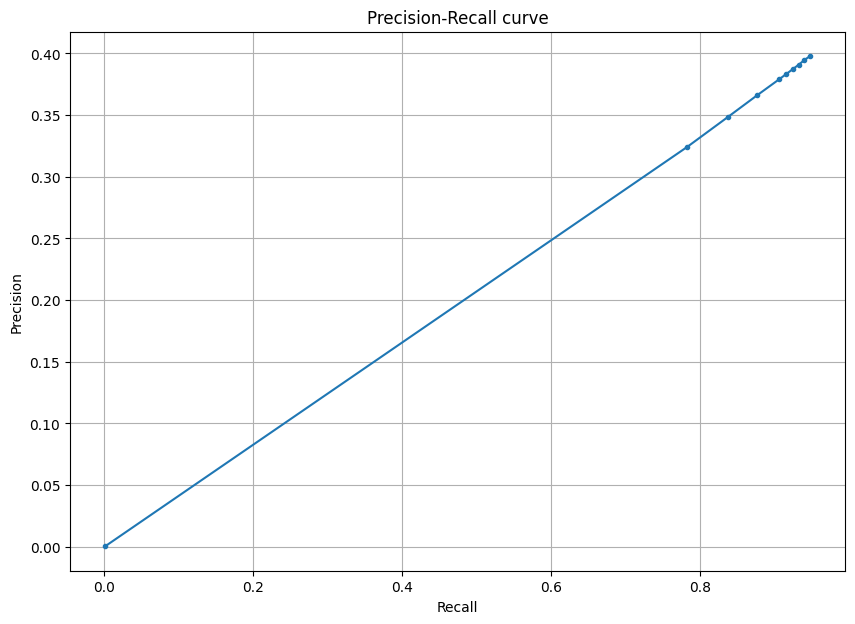

In [ ]:
plot_avg_precision_recall_curve(ground_truth, SAM_pred)

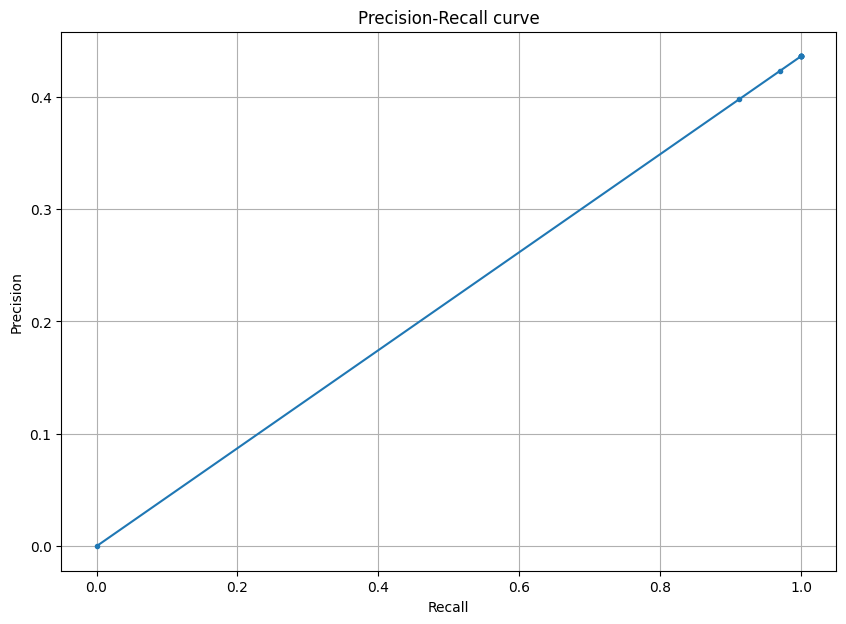

In [ ]:
plot_precision_recall_curve(ground_truth['IMG_9998_p14'], SAM_pred['IMG_9998_p14'])

## Save ground truth and sam preditions

In [ ]:
import pickle

with open("SAM_pred.pickle", "wb") as f:
    pickle.dump(SAM_pred, f)

with open("ground_truth.pickle", "wb") as f:
    pickle.dump(ground_truth, f)

# New Session begin

In [ ]:
import pickle

with open('/content/drive/MyDrive/Thesis: Cannabis maturity assessment project/trichomes patches - week5 3xzoom/analysis/SAM_pred.pickle', 'rb') as f:
    SAM_pred = pickle.load(f)

with open('/content/drive/MyDrive/Thesis: Cannabis maturity assessment project/trichomes patches - week5 3xzoom/analysis/ground_truth.pickle', 'rb') as f:
    ground_truth = pickle.load(f)